In [1]:
'''
Created on Jul 16, 2017

@author: Matthew Gregory Krupa

Excluding IsBiHeap(), the functions given below  
are the minimum needed to biheapify a collection
of objects comparable objects.
For the commented versions of these functions 
containing explanations of the source code, 
see the C++ files biheapify_common.h, biheapify_even.h
biheapify_odd.h, and biheapify.h.
'''

def GetLeftChild(node):
    return (2 * node) + 1

def GetRightChild(node):
    return 2 * (node + 1)

def GetParentNotRoot(node):
    return (node - 1) // 2

def HeapSize(total_num_nodes):
    return total_num_nodes - (total_num_nodes // 3)

def PureHeapSize(total_num_nodes):
    return (total_num_nodes + 1) // 2

def GetOffsetOfFirstMinHeapInArrow(total_num_nodes, heap_size):
    return total_num_nodes - heap_size

def GetOffsetOfFirstMinHeapInArrow(total_num_nodes):
    return GetOffsetOfFirstMinHeapInArrow(total_num_nodes, HeapSize(total_num_nodes))

def GetNumNodesBetweenFistAndLastInArrows(total_num_nodes, offset_of_first_min_heap_in_arrow):
    return offset_of_first_min_heap_in_arrow + (total_num_nodes % 3)

def GetNumNodesBetweenFistAndLastInArrows(total_num_nodes):
    return GetNumNodesBetweenFistAndLastInArrows(total_num_nodes, GetOffsetOfFirstMinHeapInArrow(total_num_nodes))

#FlipCo is short for Flip Coordinate to (resp. from) an hc coordinate from (resp. to) an mc coordinate
def FlipCo(co, total_num_nodes):
    return total_num_nodes - 1 - co

def SiftUpMinHeapHC(li, pos_hc, smallest_node_in_biheap_hc):
    if pos_hc <= 0:
        return 
    parent = GetParentNotRoot(pos_hc)
    if parent < smallest_node_in_biheap_hc:
        return
    while True:
        if li[pos_hc] < li[parent]:
            li[pos_hc], li[parent] = li[parent], li[pos_hc]
            pos_hc = parent
        else:
            return
        if pos_hc <= 0:
            return
        parent = GetParentNotRoot(pos_hc)
        if parent < smallest_node_in_biheap_hc:
            return
    return

def SiftUpMaxHeapMC(li, total_num_nodes, pos_mc, smallest_node_in_biheap_mc):
    if pos_mc <= 0:
        return 
    parent_mc = GetParentNotRoot(pos_mc)
    if parent_mc < smallest_node_in_biheap_mc:
        return
    pos_hc = FlipCo(pos_mc, total_num_nodes)
    parent_hc = FlipCo(parent_mc, total_num_nodes)
    while True:
        if li[pos_hc] > li[parent_hc]:
            li[pos_hc], li[parent_hc] = li[parent_hc], li[pos_hc]
            pos_mc = parent_mc
            pos_hc = parent_hc
        else:
            return
        if pos_mc <= 0:
            return
        parent_mc = GetParentNotRoot(pos_mc)
        if parent_mc < smallest_node_in_biheap_mc:
            return
        parent_hc = FlipCo(parent_mc, total_num_nodes)
    return

def SiftUpMaxHeapHC(li, total_num_nodes, pos_hc, smallest_node_in_biheap_mc):
    SiftUpMaxHeapMC(li, total_num_nodes, FlipCo(pos_hc, total_num_nodes), smallest_node_in_biheap_mc)
    return 
        
def SiftFromMinToMax(li, total_num_nodes, heap_size, first_node_in_mirror_heap, pos_hc, largest_node_in_biheap_hc):
    while pos_hc < first_node_in_mirror_heap:
        left_child_hc   = GetLeftChild(pos_hc)
        right_child_hc  = left_child_hc + 1
        smaller_hc      = None
        is_right_child_valid = right_child_hc < heap_size and right_child_hc <= largest_node_in_biheap_hc
        if is_right_child_valid and (li[right_child_hc] < li[left_child_hc]):
            smaller_hc = right_child_hc
        else:
            smaller_hc = left_child_hc
        if li[pos_hc] > li[smaller_hc]:
            li[pos_hc], li[smaller_hc] = li[smaller_hc], li[pos_hc]
            pos_hc = smaller_hc
        else:
            return
    SiftUpMaxHeapMC(li, total_num_nodes, FlipCo(pos_hc, total_num_nodes), FlipCo(largest_node_in_biheap_hc, total_num_nodes))
    return

def SiftFromMaxToMin(li, total_num_nodes, heap_size, first_node_in_mirror_heap, pos_mc, smallest_node_in_biheap_hc):
    pos_hc = FlipCo(pos_mc, total_num_nodes)
    while pos_mc < first_node_in_mirror_heap:
        left_child_mc  = GetLeftChild(pos_mc)
        right_child_mc = left_child_mc + 1
        left_child_hc  = FlipCo(left_child_mc, total_num_nodes)
        right_child_hc = left_child_hc - 1
        larger_hc      = None
        is_right_child_valid = right_child_mc < heap_size
        if is_right_child_valid and (li[right_child_hc] > li[left_child_hc]):
            larger_hc = right_child_hc
            pos_mc    = right_child_mc
        else:
            larger_hc = left_child_hc
            pos_mc    = left_child_mc
        if li[pos_hc] < li[larger_hc]:
            li[pos_hc], li[larger_hc] = li[larger_hc], li[pos_hc]
            pos_hc = larger_hc
        else:
            return
    SiftUpMinHeapHC(li, pos_hc, smallest_node_in_biheap_hc)
    return

def BiHeapify(li, total_num_nodes):
    if total_num_nodes < 2:
        return
    heap_size = HeapSize(total_num_nodes)
    first_node_in_mirror_heap = total_num_nodes - heap_size
    largest_node_in_biheap_hc = heap_size - 1
    if total_num_nodes % 3 == 2:
        largest_node_in_biheap_hc = largest_node_in_biheap_hc - 1
    smallest_node_in_biheap_hc = FlipCo(largest_node_in_biheap_hc, total_num_nodes)
    
    while smallest_node_in_biheap_hc > 0:
        smallest_node_in_biheap_hc = smallest_node_in_biheap_hc - 1
        SiftFromMinToMax(li, total_num_nodes, heap_size, first_node_in_mirror_heap, smallest_node_in_biheap_hc, largest_node_in_biheap_hc)
        largest_node_in_biheap_hc = largest_node_in_biheap_hc + 1
        SiftFromMaxToMin(li, total_num_nodes, heap_size, first_node_in_mirror_heap, FlipCo(largest_node_in_biheap_hc, total_num_nodes), smallest_node_in_biheap_hc)
    return

def BiHeapifySub(li, start_index, total_num_nodes):
    sublist = li[start_index:start_index + total_num_nodes]
    BiHeapify(sublist, total_num_nodes)
    li[start_index:start_index + total_num_nodes] = sublist
    return
        
def IsBiheap(li, total_num_nodes):
    if total_num_nodes <= 3:
        if total_num_nodes <= 1:
            return True
        elif total_num_nodes == 2:
            return li[0] <= li[1]
        else:
            return li[0] <= li[1] and li[1] <= li[2]
    heap_size = HeapSize(total_num_nodes)
    #Check that the first heap_size nodes form a min heap.
    i = 0
    right_child = GetRightChild(i)
    while right_child < heap_size:
        if li[i] > li[right_child - 1]:
            return False
        if li[i] > li[right_child]:
            return False
        i = i + 1
        right_child = GetRightChild(i)
    #if the min heap has a single left child then check that it satisfies the min heap condition.
    left_child = GetLeftChild(i)
    if (left_child < heap_size and li[i] > li[left_child]):
        return False
    #Check that the last heap_size nodes form a max heap.
    i_mc = 0
    right_child_mc = GetRightChild(i_mc)
    while right_child_mc < heap_size:
        i_hc = FlipCo(i_mc, total_num_nodes)
        right_child_hc = FlipCo(right_child_mc, total_num_nodes)
        left_child_hc = FlipCo(right_child_mc - 1, total_num_nodes)
        if li[i_hc] < li[left_child_hc]:
            return False
        if li[i_hc] < li[right_child_hc]:
            return False
        i_mc = i_mc + 1
        right_child_mc = GetRightChild(i_mc)
    #if the max heap has a single left child then check that it satisfies the max heap condition.
    left_child_mc = GetLeftChild(i_mc)
    left_child_hc = FlipCo(left_child_mc, total_num_nodes)
    i_hc = FlipCo(i_mc, total_num_nodes)
    if (left_child_mc < heap_size and li[i_hc] < li[left_child_hc]):
        return False
    return True

################################################################
#Begin: BiHeapify() With Start Offset
################################################################

def SiftUpMinHeapHCWithOffset(li, start_offset, pos_hc, smallest_node_in_biheap_hc):
    if pos_hc <= 0:
        return 
    parent = GetParentNotRoot(pos_hc)
    if parent < smallest_node_in_biheap_hc:
        return
    while True:
        if li[start_offset + pos_hc] < li[start_offset + parent]:
            li[start_offset + pos_hc], li[start_offset + parent] = li[start_offset + parent], li[start_offset + pos_hc]
            pos_hc = parent
        else:
            return
        if pos_hc <= 0:
            return
        parent = GetParentNotRoot(pos_hc)
        if parent < smallest_node_in_biheap_hc:
            return
    return

def SiftUpMaxHeapMCWithOffset(li, start_offset, total_num_nodes, pos_mc, smallest_node_in_biheap_mc):
    if pos_mc <= 0:
        return 
    parent_mc = GetParentNotRoot(pos_mc)
    if parent_mc < smallest_node_in_biheap_mc:
        return
    pos_hc = FlipCo(pos_mc, total_num_nodes)
    parent_hc = FlipCo(parent_mc, total_num_nodes)
    while True:
        if li[start_offset + pos_hc] > li[start_offset + parent_hc]:
            li[start_offset + pos_hc], li[start_offset + parent_hc] = li[start_offset + parent_hc], li[start_offset + pos_hc]
            pos_mc = parent_mc
            pos_hc = parent_hc
        else:
            return
        if pos_mc <= 0:
            return
        parent_mc = GetParentNotRoot(pos_mc)
        if parent_mc < smallest_node_in_biheap_mc:
            return
        parent_hc = FlipCo(parent_mc, total_num_nodes)
    return

def SiftUpMaxHeapHCWithOffset(li, start_offset, total_num_nodes, pos_hc, smallest_node_in_biheap_mc):
    SiftUpMaxHeapMCWithOffset(li, start_offset, total_num_nodes, FlipCo(pos_hc, total_num_nodes), smallest_node_in_biheap_mc)
    return 

def SiftFromMinToMaxWithOffset(li, start_offset, total_num_nodes, heap_size, first_node_in_mirror_heap, pos_hc, largest_node_in_biheap_hc):
    while pos_hc < first_node_in_mirror_heap:
        left_child_hc   = GetLeftChild(pos_hc)
        right_child_hc  = left_child_hc + 1
        smaller_hc      = None
        is_right_child_valid = right_child_hc < heap_size and right_child_hc <= largest_node_in_biheap_hc
        if is_right_child_valid and (li[start_offset + right_child_hc] < li[start_offset + left_child_hc]):
            smaller_hc = right_child_hc
        else:
            smaller_hc = left_child_hc
        if li[start_offset + pos_hc] > li[start_offset + smaller_hc]:
            li[start_offset + pos_hc], li[start_offset + smaller_hc] = li[start_offset + smaller_hc], li[start_offset + pos_hc]
            pos_hc = smaller_hc
        else:
            return
    SiftUpMaxHeapMCWithOffset(li, start_offset, total_num_nodes, FlipCo(pos_hc, total_num_nodes), FlipCo(largest_node_in_biheap_hc, total_num_nodes))
    return

def SiftFromMaxToMinWithOffset(li, start_offset, total_num_nodes, heap_size, first_node_in_mirror_heap, pos_mc, smallest_node_in_biheap_hc):
    pos_hc = FlipCo(pos_mc, total_num_nodes)
    while pos_mc < first_node_in_mirror_heap:
        left_child_mc  = GetLeftChild(pos_mc)
        right_child_mc = left_child_mc + 1
        left_child_hc  = FlipCo(left_child_mc, total_num_nodes)
        right_child_hc = left_child_hc - 1
        larger_hc      = None
        is_right_child_valid = right_child_mc < heap_size
        if is_right_child_valid and (li[start_offset + right_child_hc] > li[start_offset + left_child_hc]):
            larger_hc = right_child_hc
            pos_mc    = right_child_mc
        else:
            larger_hc = left_child_hc
            pos_mc    = left_child_mc
        if li[start_offset + pos_hc] < li[start_offset + larger_hc]:
            li[start_offset + pos_hc], li[start_offset + larger_hc] = li[start_offset + larger_hc], li[start_offset + pos_hc]
            pos_hc = larger_hc
        else:
            return
    SiftUpMinHeapHCWithOffset(li, start_offset, pos_hc, smallest_node_in_biheap_hc)
    return

def BiHeapifyWithOffset(li, start_index, total_num_nodes):
    if total_num_nodes < 2:
        return
    heap_size = HeapSize(total_num_nodes)
    first_node_in_mirror_heap  = total_num_nodes - heap_size
    largest_node_in_biheap_hc = heap_size - 1
    if total_num_nodes % 3 == 2:
        largest_node_in_biheap_hc = largest_node_in_biheap_hc - 1
    smallest_node_in_biheap_hc = FlipCo(largest_node_in_biheap_hc, total_num_nodes)
    while smallest_node_in_biheap_hc > 0:
        smallest_node_in_biheap_hc = smallest_node_in_biheap_hc - 1
        SiftFromMinToMaxWithOffset(li, start_index, total_num_nodes, heap_size, first_node_in_mirror_heap, smallest_node_in_biheap_hc, largest_node_in_biheap_hc)
        largest_node_in_biheap_hc = largest_node_in_biheap_hc + 1
        SiftFromMaxToMinWithOffset(li, start_index, total_num_nodes, heap_size, first_node_in_mirror_heap, FlipCo(largest_node_in_biheap_hc, total_num_nodes), smallest_node_in_biheap_hc)
    return

def IsBiheapWithOffset(li, start_offset, total_num_nodes):
    if total_num_nodes <= 3:
        if total_num_nodes <= 1:
            return True
        elif total_num_nodes == 2:
            return li[start_offset] <= li[start_offset + 1]
        else:
            return li[start_offset] <= li[start_offset + 1] and li[start_offset + 1] <= li[start_offset + 2]
    num_nodes_in_heap = GetNumNodesInHeap(total_num_nodes)
    #Check that the first num_nodes_in_heap nodes form a min heap.
    i = 0
    right_child = GetRightChild(i)
    while right_child < num_nodes_in_heap:
        if li[start_offset + i] > li[start_offset + (right_child - 1)]:
            return False
        if li[start_offset + i] > li[start_offset + right_child]:
            return False
        i = i + 1
        right_child = GetRightChild(i)
    #if the min heap has a single left child then check that it satisfies the min heap condition.
    left_child = GetLeftChild(i)
    if (left_child < num_nodes_in_heap and li[start_offset + i] > li[start_offset + left_child]):
        return False
    #Check that the last num_nodes_in_heap nodes form a max heap.
    i_mc = 0
    right_child_mc = GetRightChild(i_mc)
    while right_child_mc < num_nodes_in_heap:
        i_hc = FlipCo(i_mc, total_num_nodes)
        right_child_hc = FlipCo(right_child_mc, total_num_nodes)
        left_child_hc = FlipCo(right_child_mc - 1, total_num_nodes)
        if li[start_offset + i_hc] < li[start_offset + left_child_hc]:
            return False
        if li[start_offset + i_hc] < li[start_offset + right_child_hc]:
            return False
        i_mc = i_mc + 1
        right_child_mc = GetRightChild(i_mc)
    #if the max heap has a single left child then check that it satisfies the max heap condition.
    left_child_mc = GetLeftChild(i_mc)
    left_child_hc = FlipCo(left_child_mc, total_num_nodes)
    i_hc = FlipCo(i_mc, total_num_nodes)
    if (left_child_mc < num_nodes_in_heap and li[start_offset + i_hc] < li[start_offset + left_child_hc]):
        return False
    return True

def BiHeapifyInwards(li, total_num_nodes):
    start_offset = 0
    while total_num_nodes > 7:
        BiHeapifyWithOffset(li, start_offset, total_num_nodes)
        num_nodes_in_heap      = HeapSize(total_num_nodes)
        first_extended_in_node = total_num_nodes - num_nodes_in_heap
        start_offset           = start_offset + first_extended_in_node
        total_num_nodes        = num_nodes_in_heap - first_extended_in_node
    if total_num_nodes > 1:
          li[start_offset:start_offset + total_num_nodes] = sorted(li[start_offset:start_offset + total_num_nodes])
    return

def BiHeapifyInwardsWithOffset(li, start_offset, total_num_nodes):
    while total_num_nodes > 7:
        BiHeapifyWithOffset(li, start_offset, total_num_nodes)
        num_nodes_in_heap      = HeapSize(total_num_nodes)
        first_extended_in_node = total_num_nodes - num_nodes_in_heap
        start_offset           = start_offset + first_extended_in_node
        total_num_nodes        = num_nodes_in_heap - first_extended_in_node
    if total_num_nodes > 1:
          li[start_offset:start_offset + total_num_nodes] = sorted(li[start_offset:start_offset + total_num_nodes])
    return

def CountNumberOfElementsLessThanOrEqualToAndGreaterThanOrEqualToValues(li, start_offset, total_num_nodes, value_le, value_ge):
    counter_less_than_or_equal_to = 0
    counter_greater_than_or_equal_to = 0
    i = 0
    while i < total_num_nodes:
        if li[start_offset + i] <= value_le:
            counter_less_than_or_equal_to += 1
        if li[start_offset + i] >= value_ge:
            counter_greater_than_or_equal_to += 1
        i += 1
    return (counter_less_than_or_equal_to, counter_greater_than_or_equal_to)

def CheckRatioOfNumValuesAboveAndBelowPivot(li, start_offset, total_num_nodes, ratio = 0.25):
    if total_num_nodes < 2:
        return True
    left_middle_offset = (total_num_nodes - 1) // 2
    right_middle_offset = total_num_nodes // 2
    value_left = li[start_offset + left_middle_offset]
    value_right = li[start_offset + right_middle_offset]
    num_le, num_ge = CountNumberOfElementsLessThanOrEqualToAndGreaterThanOrEqualToValues(li, start_offset, total_num_nodes, value_left, value_right)
    threshold = ratio * total_num_nodes
    if num_le < threshold or num_ge < threshold:
        print('Failed to have at least ratio * total_num_nodes =', threshold, 'elements >= (or <=) pivot where total_num_nodes =', total_num_nodes)
        return False
    return True

def BiHeapifyInwardsRecursiveWithVerification(li, start_offset, total_num_nodes, ratio = 0.25):
  if total_num_nodes < 8: 
      if total_num_nodes > 1:
          li[start_offset:start_offset + total_num_nodes] = sorted(li[start_offset:start_offset + total_num_nodes])
      return True
  BiHeapifyWithOffset(li, start_offset, total_num_nodes);
  num_nodes_in_heap      = HeapSize(total_num_nodes)
  first_extended_in_node = total_num_nodes - num_nodes_in_heap
  new_start_offset = start_offset + first_extended_in_node
  new_total_num_nodes = num_nodes_in_heap - first_extended_in_node
  was_correct = BiHeapifyInwardsRecursiveWithVerification(li, new_start_offset, new_total_num_nodes, ratio)
  is_correct = was_correct and CheckRatioOfNumValuesAboveAndBelowPivot(li, start_offset, total_num_nodes, ratio)
  return is_correct

In [2]:
import random
def BiheapifyTestCorrectness():
    list_size_start = 1
    list_size_end = 2**10
    list_size_increment = 1
    list_size_start_exponential_growth_threshold = 2**10
    list_size_exponential_growth_divisor = 2^4
    list_size = list_size_start
    num_random_lists_per_vec_size = 2**17
    while list_size <= list_size_end:
        for _ in range(num_random_lists_per_vec_size):
            li = [100 * random.random() for _ in range(list_size)]
            BiHeapify(li, list_size)
            if IsBiheap(li, list_size) == False:
                print('List of size ', list_size, ' is not a biheap:')
                print(li)
        print('All', num_random_lists_per_vec_size, 'lists of size list_size =', 
              list_size, 'have been successfully biheapified.')
        if list_size >= list_size_start_exponential_growth_threshold:#If list_size should increase exponentially
            list_size += list_size // list_size_exponential_growth_divisor
        else:
            list_size += list_size_increment #Else increment list_size linearly.
    return 

#BiheapifyTestCorrectness()

#Tests whether or not at least 100*ratio elements are above the
# pivot element. Ditto for below the pivot element.
#Note that there do exist initial states of li where this 
# will not be true but when the list is randomly generated
# then the chance of this occuring appears to be so small 
# that despite the billions of lists that I've generated,
# I've yet to even once randomly generated a list
# where this was false. 
def BiheapifyInwardsTestRatioAboveAndBelow(ratio = 0.25):
    list_size_start = 1
    list_size_end = 2**18
    list_size_increment = 1
    list_size_start_exponential_growth_threshold = 2**10
    list_size_exponential_growth_divisor = 2^4
    list_size = list_size_start
    num_random_lists_per_vec_size = 2**20
    while list_size <= list_size_end:
        for _ in range(num_random_lists_per_vec_size):
            li = [100 * random.random() for _ in range(list_size)]
            correct = BiHeapifyInwardsRecursiveWithVerification(li, 0, list_size, ratio)
            if correct == False:
                print('List of size ', list_size, ' failed to find pivot value with ', ratio, \
                ' %of elements at or above the pivot and the same amount at or below it.')
                print(li)
                return
        print('All', num_random_lists_per_vec_size, 'lists of size list_size =', 
              list_size, 'had at least', 100*ratio, '% of their elements <= the middle value at least this number of elements >= the pivot value.')
        if list_size >= list_size_start_exponential_growth_threshold:#If list_size should increase exponentially
            list_size += list_size // list_size_exponential_growth_divisor
        else:
            list_size += list_size_increment #Else increment list_size linearly.
    return

#BiheapifyInwardsTestRatioAboveAndBelow()

list_size = 64 BiHeapify() will be applied to:


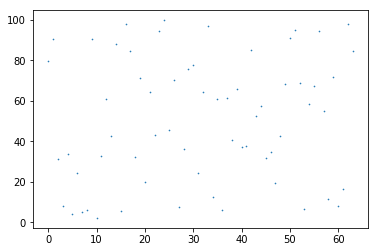

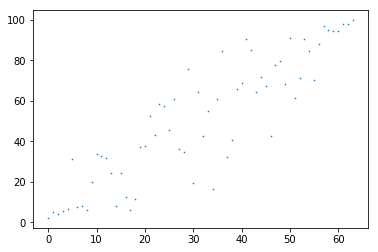

list_size = 129 BiHeapify() will be applied to:


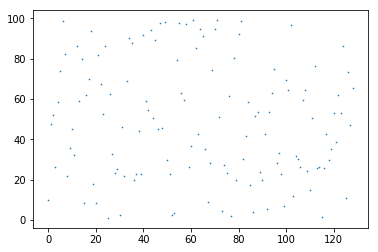

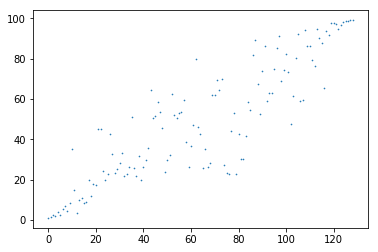

list_size = 194 BiHeapify() will be applied to:


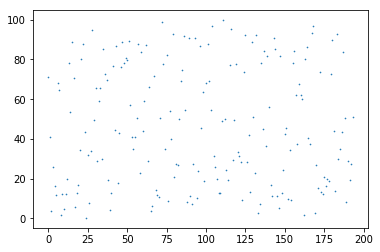

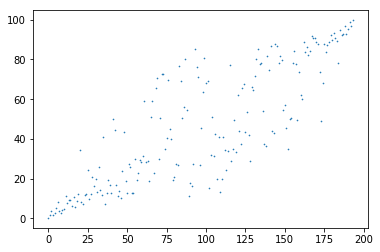

list_size = 259 BiHeapify() will be applied to:


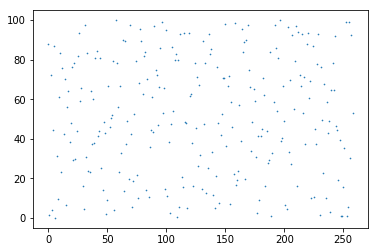

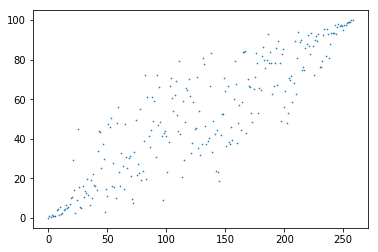

list_size = 324 BiHeapify() will be applied to:


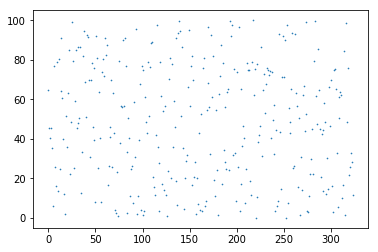

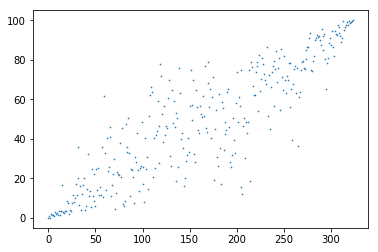

list_size = 389 BiHeapify() will be applied to:


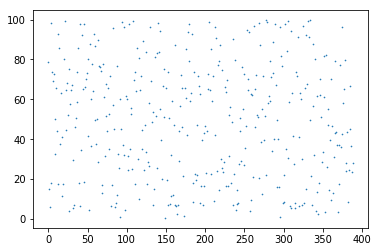

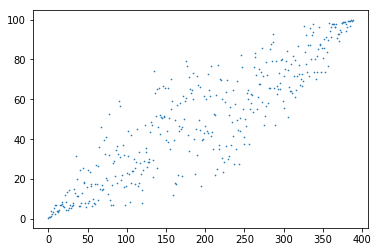

list_size = 454 BiHeapify() will be applied to:


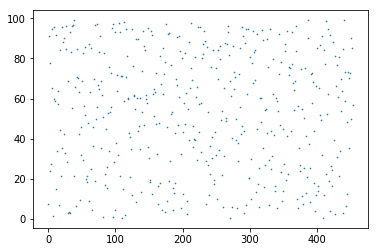

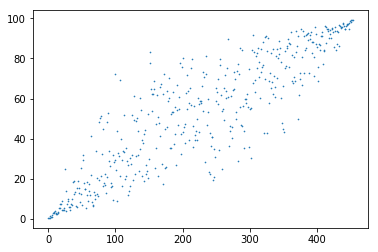

list_size = 519 BiHeapify() will be applied to:


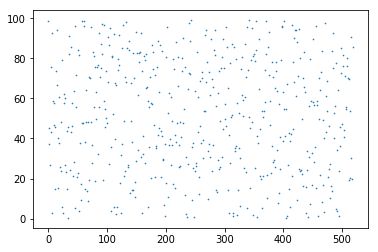

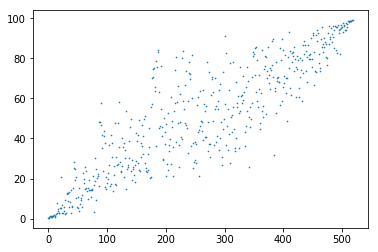

list_size = 584 BiHeapify() will be applied to:


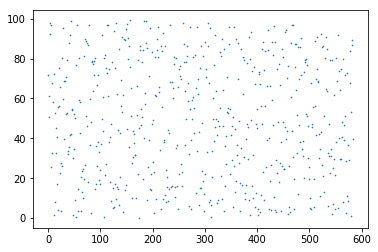

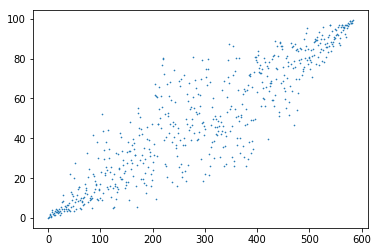

list_size = 649 BiHeapify() will be applied to:


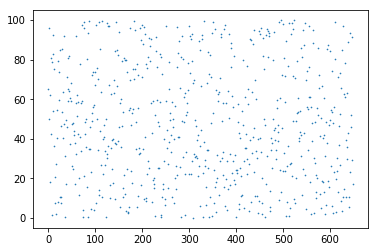

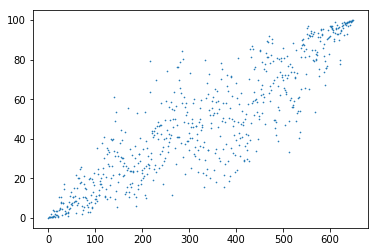

list_size = 714 BiHeapify() will be applied to:


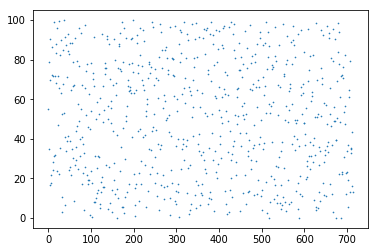

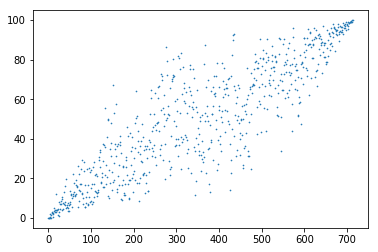

list_size = 779 BiHeapify() will be applied to:


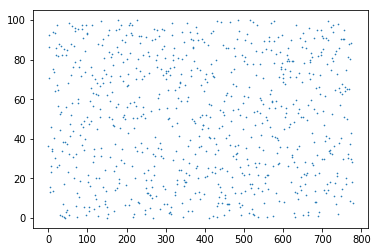

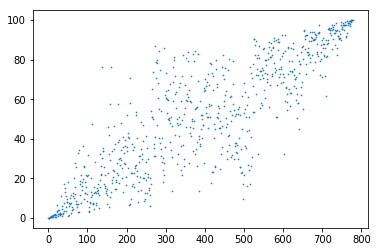

list_size = 844 BiHeapify() will be applied to:


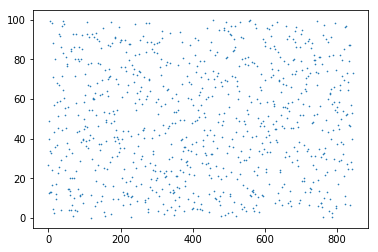

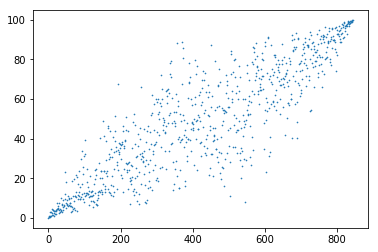

list_size = 909 BiHeapify() will be applied to:


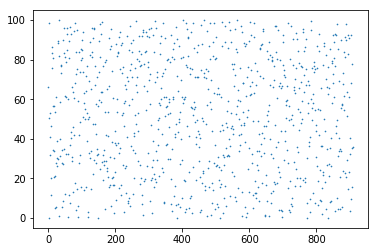

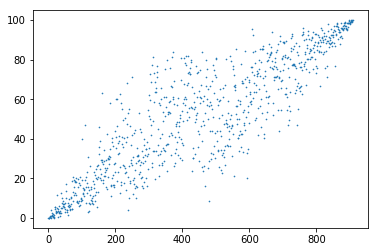

list_size = 974 BiHeapify() will be applied to:


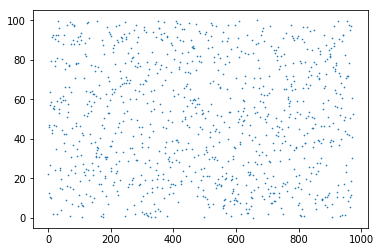

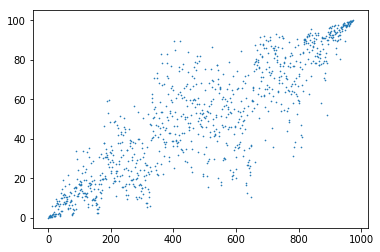

list_size = 1039 BiHeapify() will be applied to:


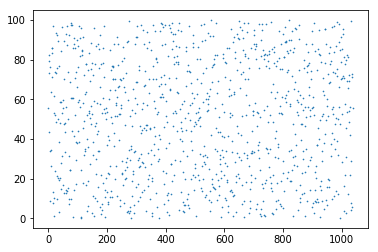

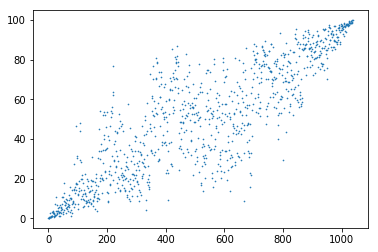

list_size = 1212 BiHeapify() will be applied to:


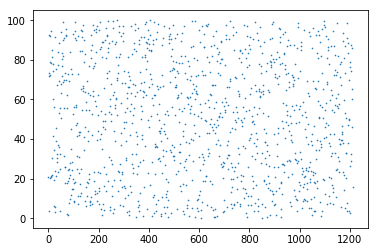

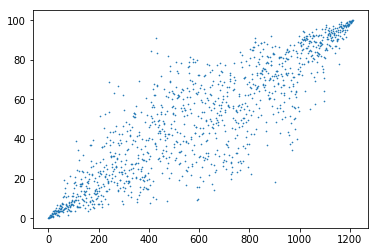

list_size = 1414 BiHeapify() will be applied to:


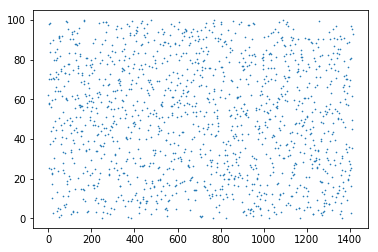

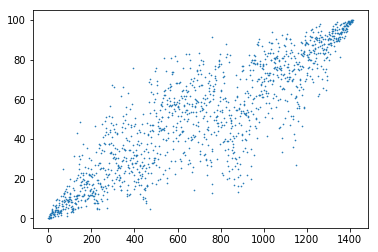

list_size = 1649 BiHeapify() will be applied to:


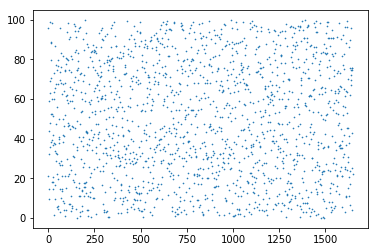

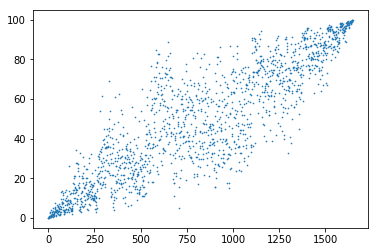

list_size = 1923 BiHeapify() will be applied to:


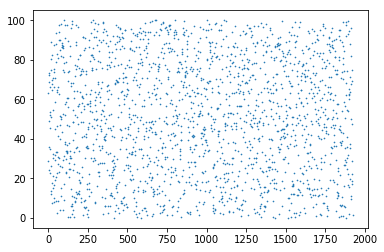

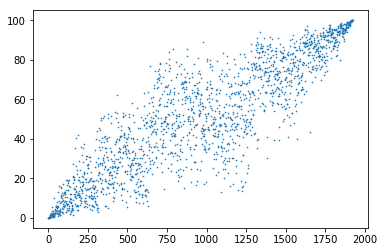

list_size = 2243 BiHeapify() will be applied to:


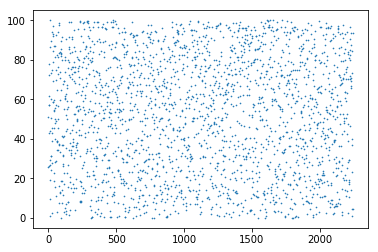

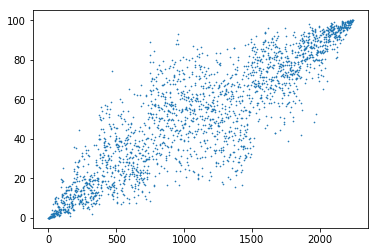

list_size = 2616 BiHeapify() will be applied to:


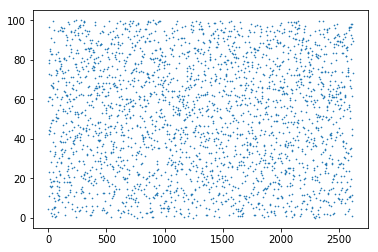

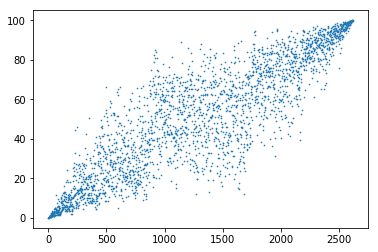

list_size = 3052 BiHeapify() will be applied to:


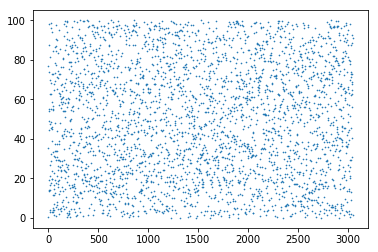

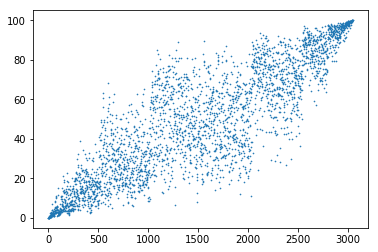

list_size = 3560 BiHeapify() will be applied to:


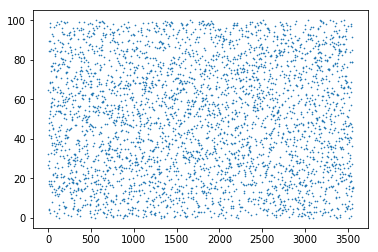

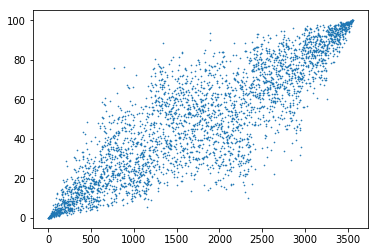

list_size = 4153 BiHeapify() will be applied to:


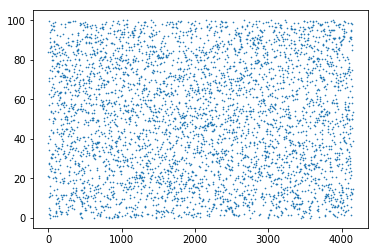

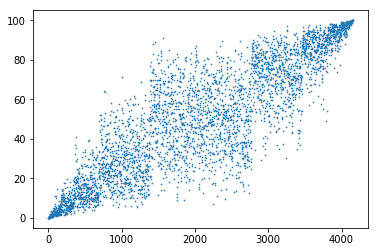

list_size = 4845 BiHeapify() will be applied to:


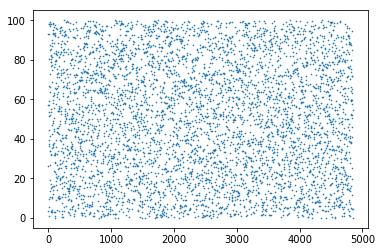

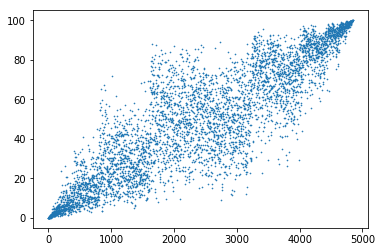

list_size = 5652 BiHeapify() will be applied to:


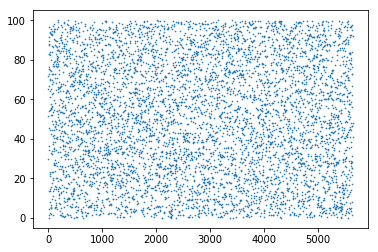

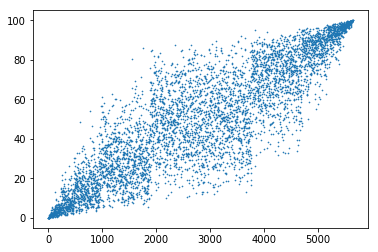

list_size = 6594 BiHeapify() will be applied to:


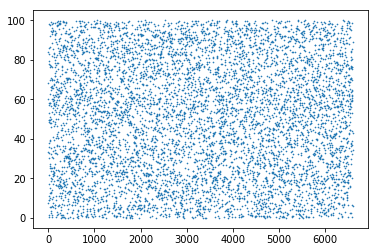

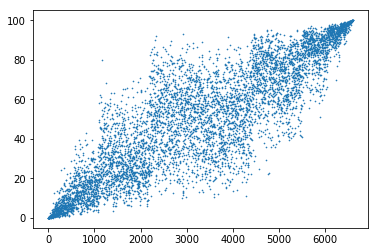

list_size = 7693 BiHeapify() will be applied to:


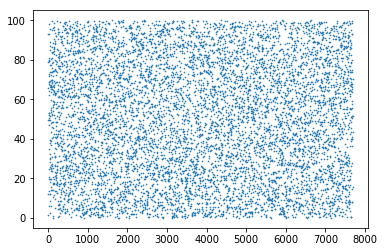

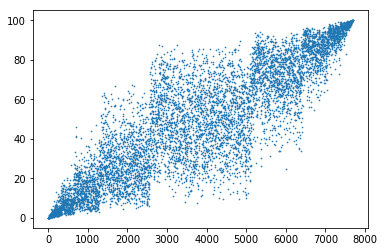

list_size = 8975 BiHeapify() will be applied to:


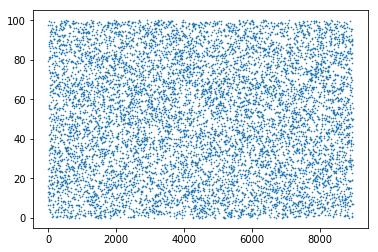

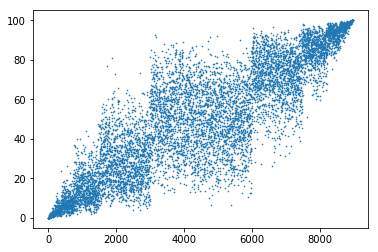

list_size = 10470 BiHeapify() will be applied to:


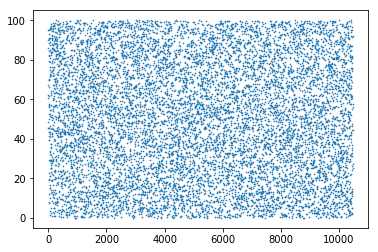

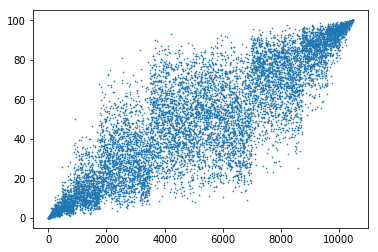

list_size = 12215 BiHeapify() will be applied to:


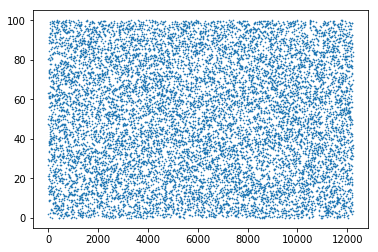

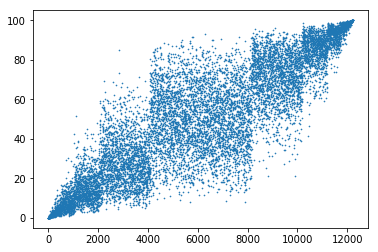

list_size = 14250 BiHeapify() will be applied to:


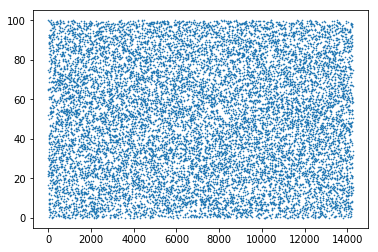

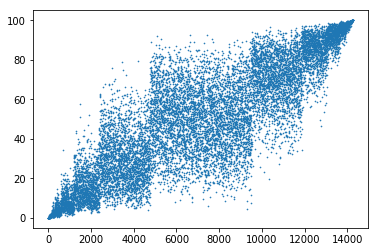

list_size = 16625 BiHeapify() will be applied to:


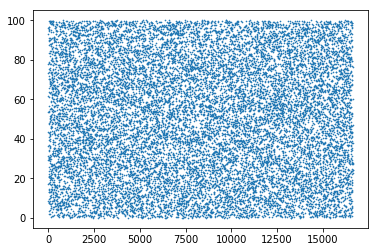

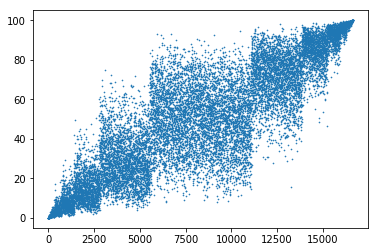

list_size = 19395 BiHeapify() will be applied to:


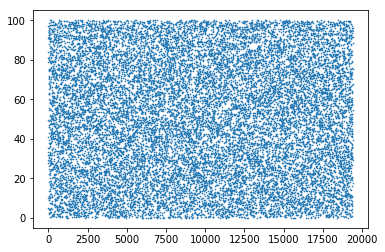

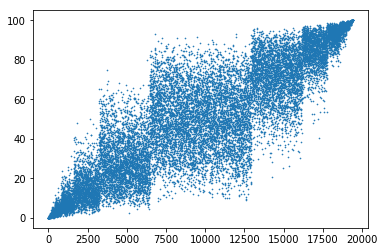

list_size = 22627 BiHeapify() will be applied to:


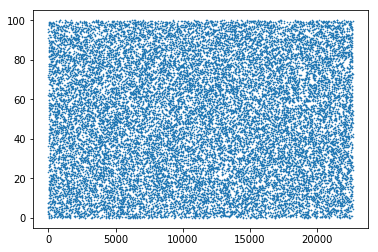

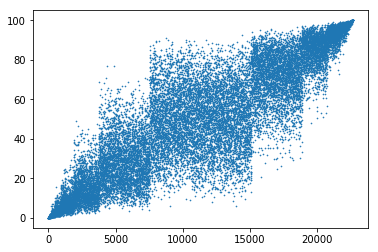

list_size = 26398 BiHeapify() will be applied to:


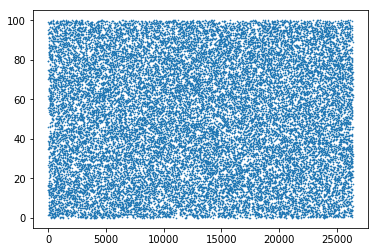

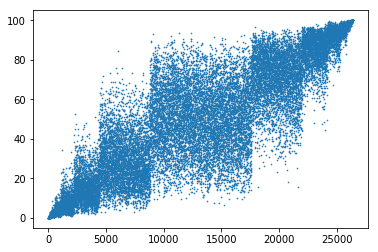

list_size = 30797 BiHeapify() will be applied to:


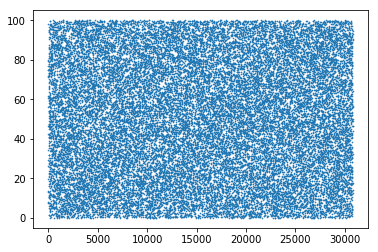

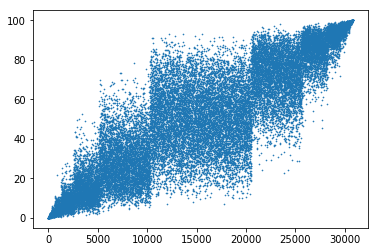

list_size = 35929 BiHeapify() will be applied to:


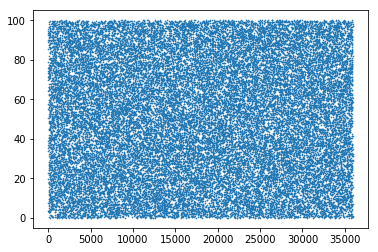

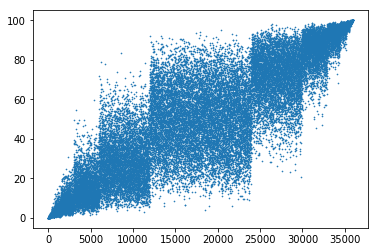

list_size = 41917 BiHeapify() will be applied to:


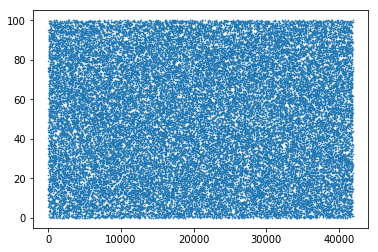

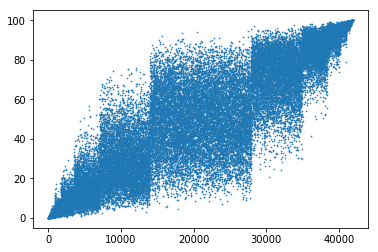

list_size = 48903 BiHeapify() will be applied to:


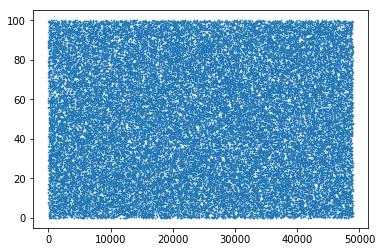

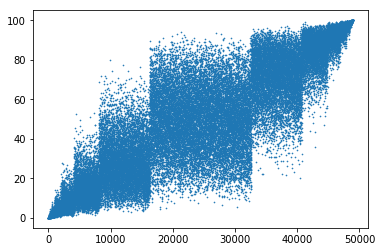

list_size = 57053 BiHeapify() will be applied to:


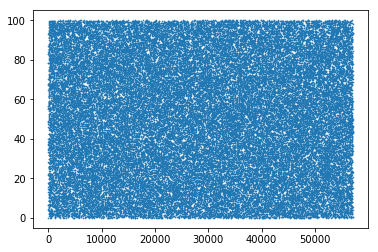

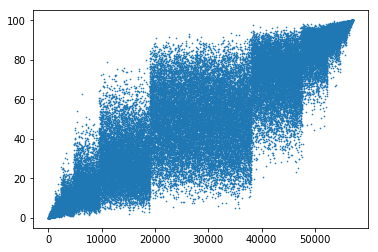

list_size = 66561 BiHeapify() will be applied to:


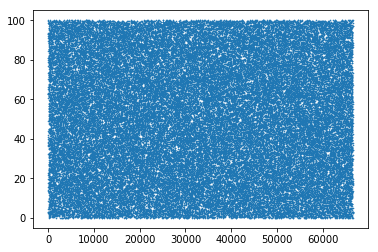

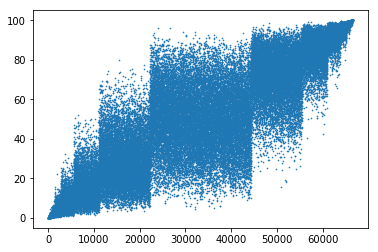

list_size = 77654 BiHeapify() will be applied to:


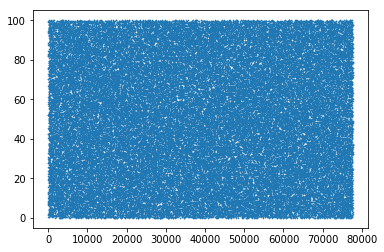

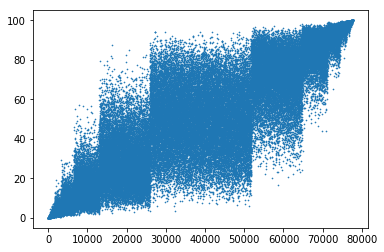

list_size = 90596 BiHeapify() will be applied to:


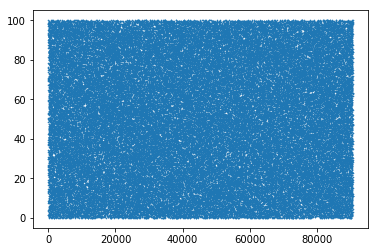

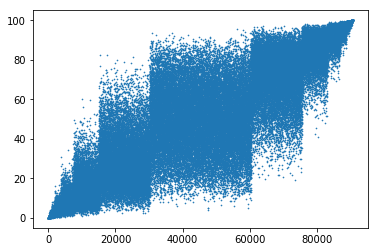

list_size = 105695 BiHeapify() will be applied to:


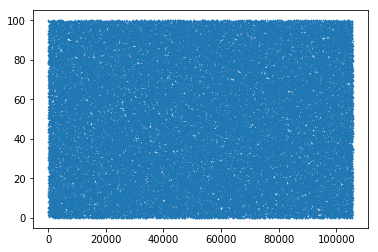

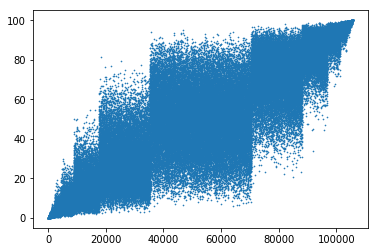

list_size = 123310 BiHeapify() will be applied to:


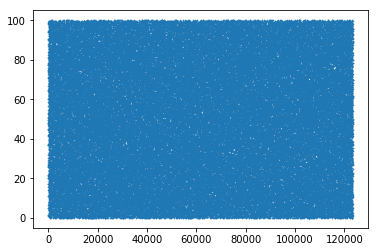

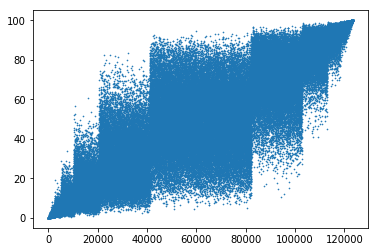

list_size = 143861 BiHeapify() will be applied to:


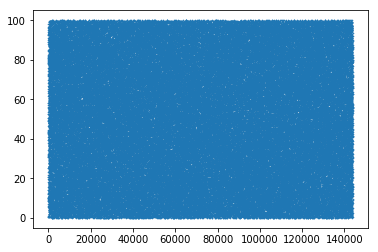

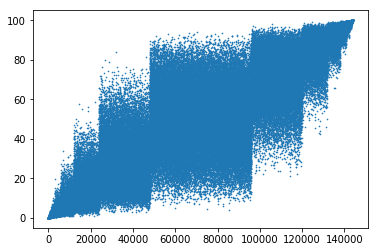

list_size = 167837 BiHeapify() will be applied to:


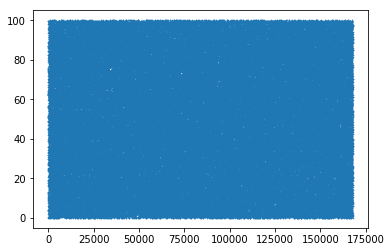

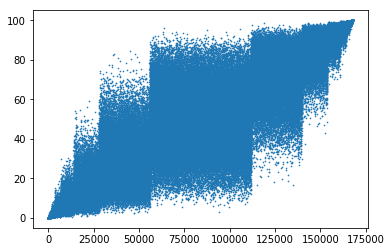

list_size = 195809 BiHeapify() will be applied to:


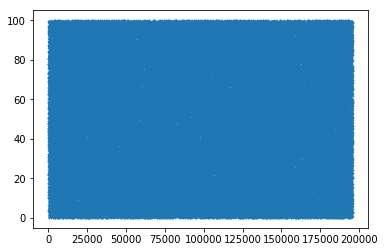

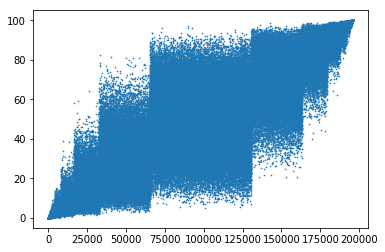

list_size = 228443 BiHeapify() will be applied to:


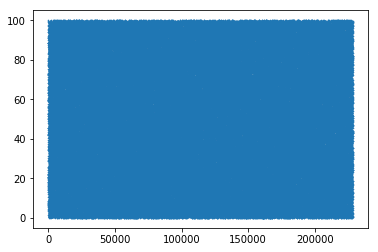

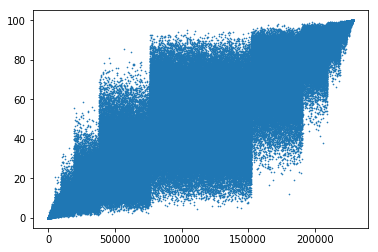

list_size = 266516 BiHeapify() will be applied to:


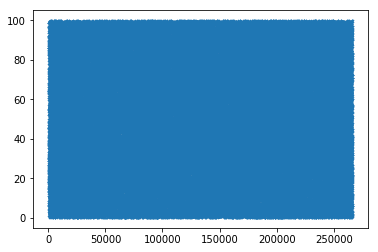

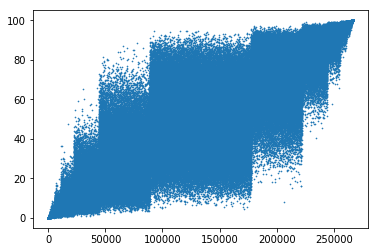

list_size = 310935 BiHeapify() will be applied to:


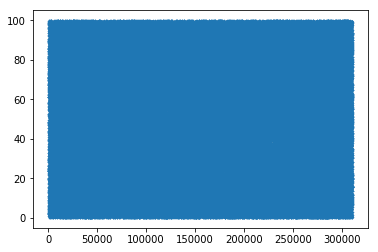

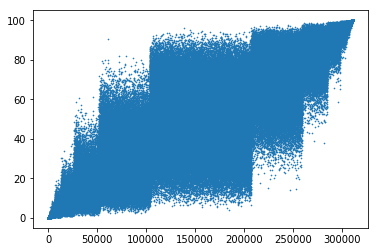

list_size = 362757 BiHeapify() will be applied to:


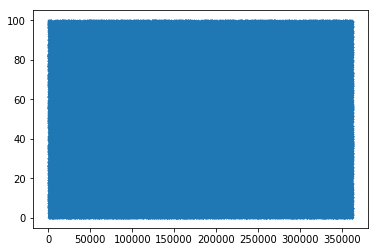

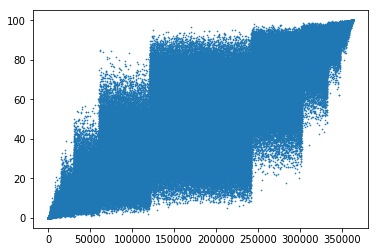

list_size = 423216 BiHeapify() will be applied to:


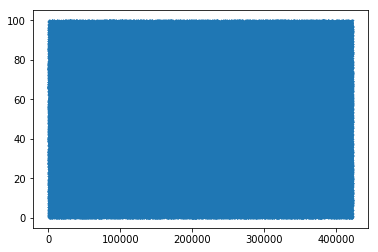

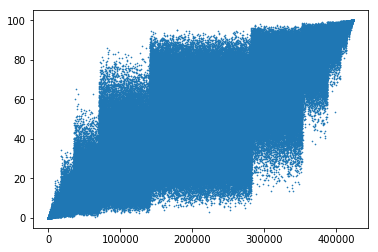

list_size = 493752 BiHeapify() will be applied to:


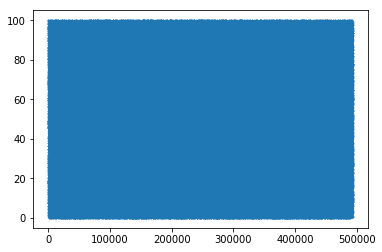

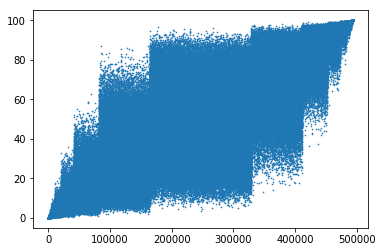

list_size = 576044 BiHeapify() will be applied to:


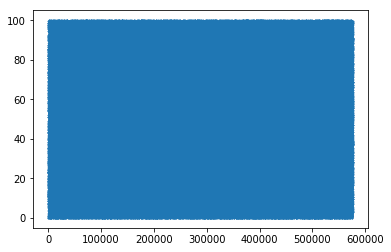

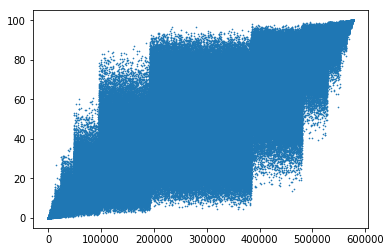

list_size = 672051 BiHeapify() will be applied to:


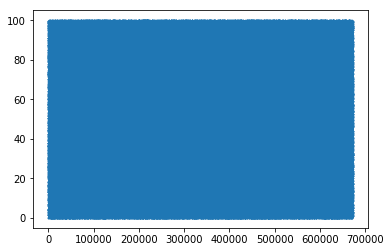

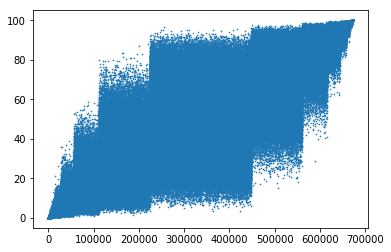

list_size = 784059 BiHeapify() will be applied to:


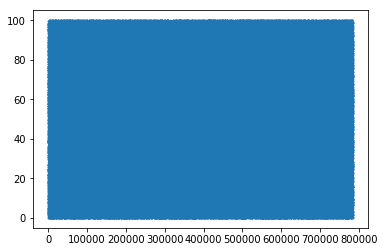

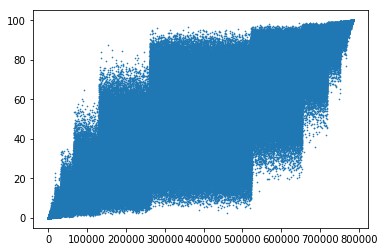

list_size = 914735 BiHeapify() will be applied to:


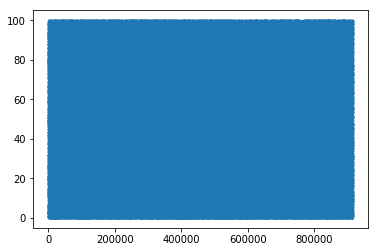

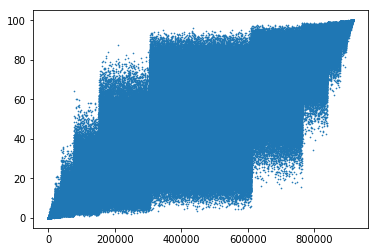

list_size = 1067190 BiHeapify() will be applied to:


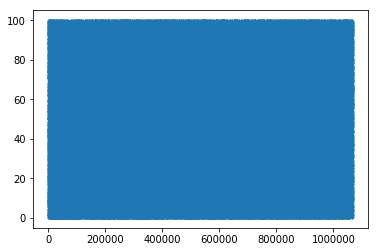

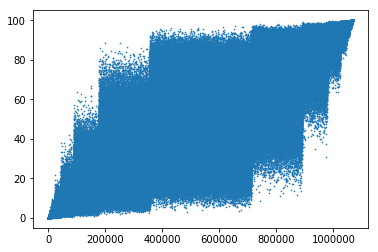

list_size = 1245055 BiHeapify() will be applied to:


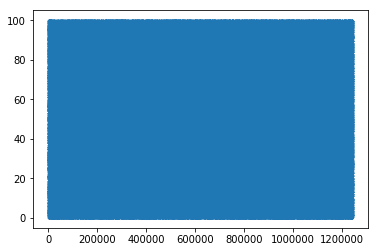

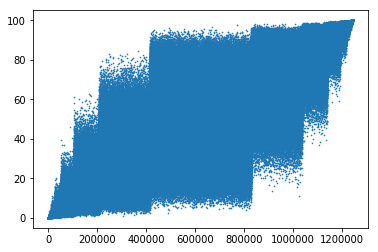

list_size = 1452564 BiHeapify() will be applied to:


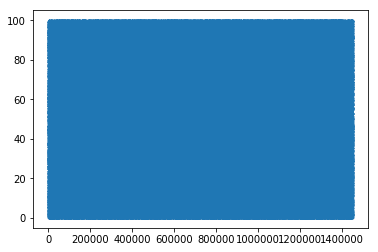

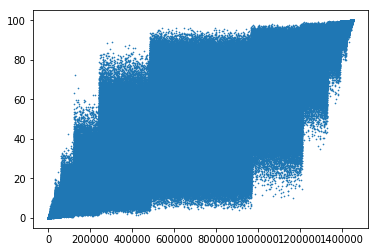

list_size = 1694658 BiHeapify() will be applied to:


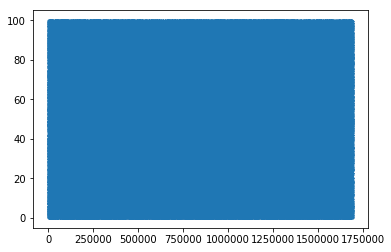

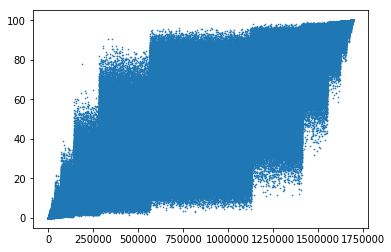

list_size = 1977101 BiHeapify() will be applied to:


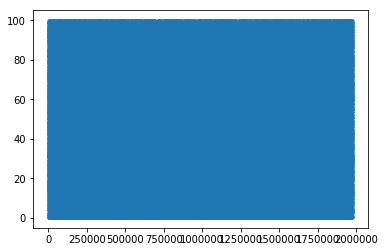

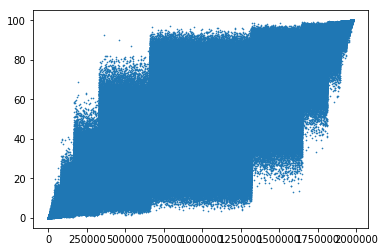

In [3]:
import matplotlib.pyplot as plt
def BiHeapifyPlot():
    list_size_start = 2**6
    list_size_end = 2**21
    list_size_increment = 2**6 + 1
    list_size_start_exponential_growth_threshold = 2**10
    list_size_exponential_growth_divisor = 2^4
    list_size = list_size_start
    num_random_lists_per_vec_size = 2**0
    scale = 0.4
    while list_size <= list_size_end:
        ints_list = [x for x in range(list_size)]
        for _ in range(num_random_lists_per_vec_size):
            print('list_size =', list_size, 'BiHeapify() will be applied to:')
            li = [100 * random.random() for _ in range(list_size)]
            plt.scatter(ints_list, li, s = scale)
            plt.show()
            BiHeapify(li, list_size)
            plt.scatter(ints_list, li, s = scale)
            plt.show()
        if list_size >= list_size_start_exponential_growth_threshold:#If list_size should increase exponentially
            list_size += list_size // list_size_exponential_growth_divisor
        else:
            list_size += list_size_increment #Else increment list_size linearly.
    return 

BiHeapifyPlot()


list_size = 64 BiHeapifyInwards() will be applied to:


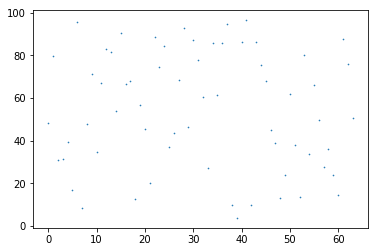

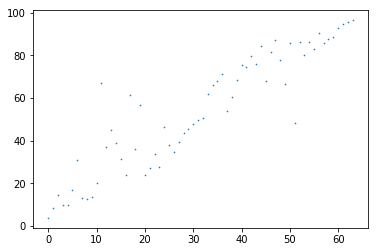

list_size = 129 BiHeapifyInwards() will be applied to:


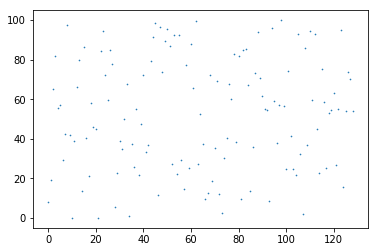

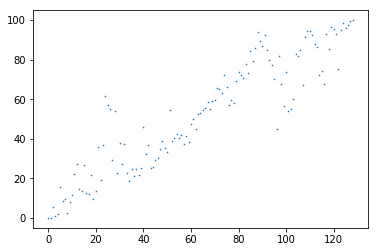

list_size = 194 BiHeapifyInwards() will be applied to:


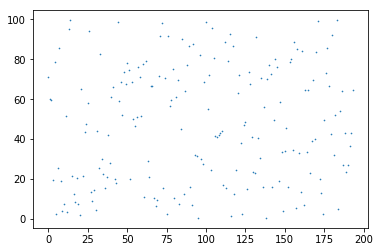

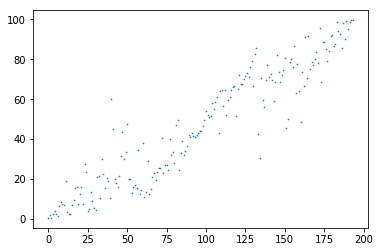

list_size = 259 BiHeapifyInwards() will be applied to:


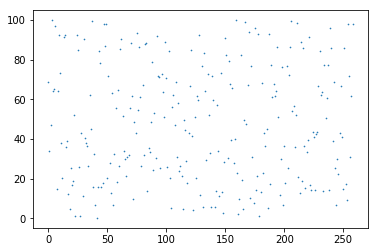

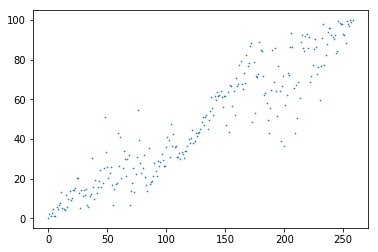

list_size = 324 BiHeapifyInwards() will be applied to:


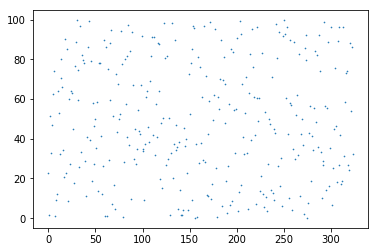

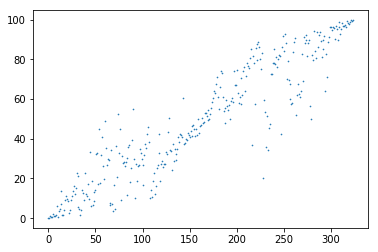

list_size = 389 BiHeapifyInwards() will be applied to:


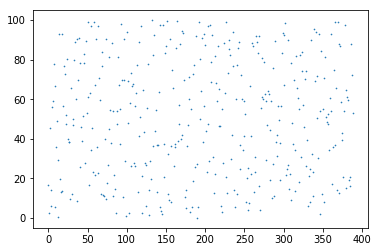

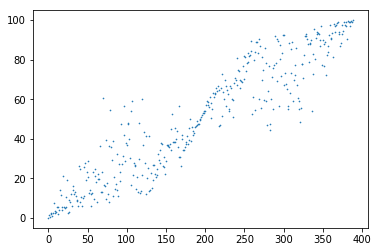

list_size = 454 BiHeapifyInwards() will be applied to:


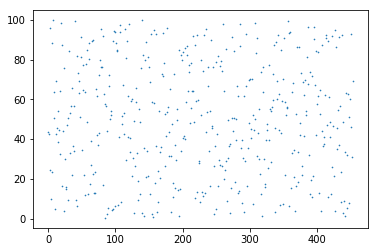

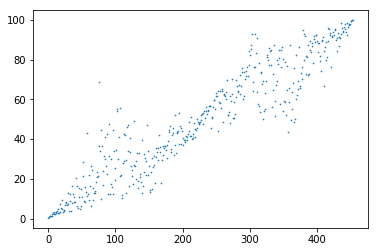

list_size = 519 BiHeapifyInwards() will be applied to:


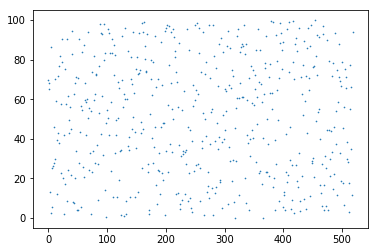

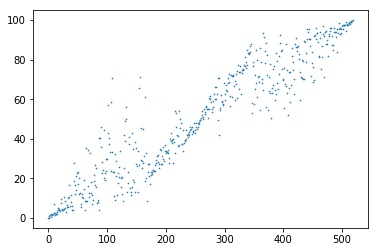

list_size = 584 BiHeapifyInwards() will be applied to:


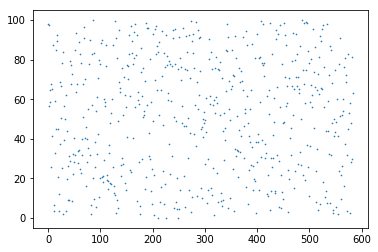

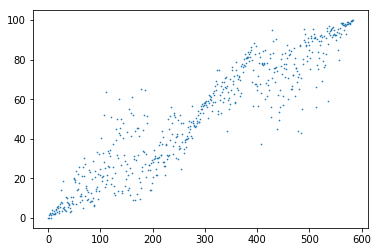

list_size = 649 BiHeapifyInwards() will be applied to:


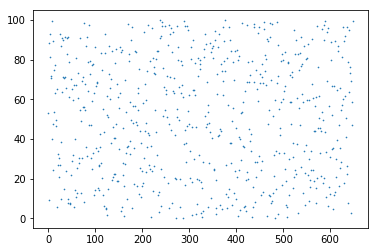

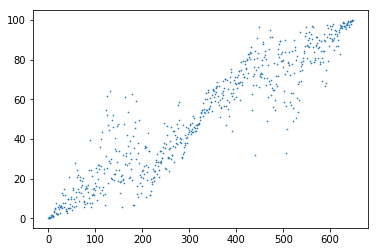

list_size = 714 BiHeapifyInwards() will be applied to:


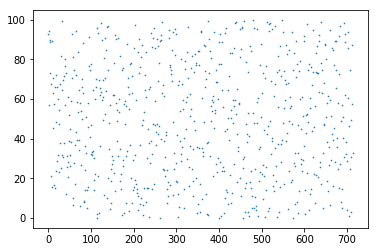

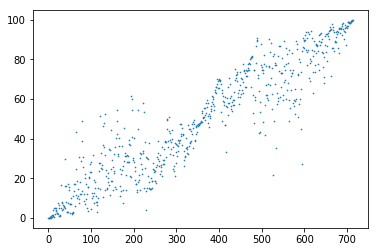

list_size = 779 BiHeapifyInwards() will be applied to:


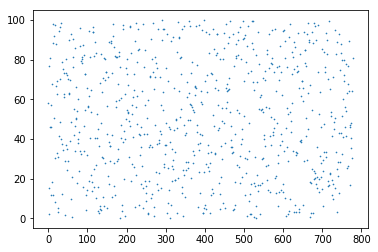

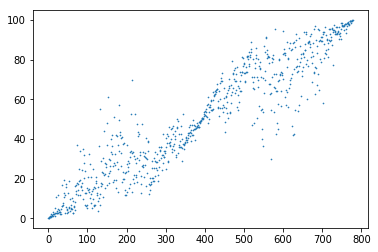

list_size = 844 BiHeapifyInwards() will be applied to:


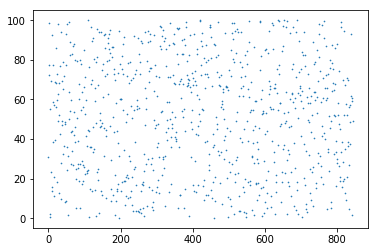

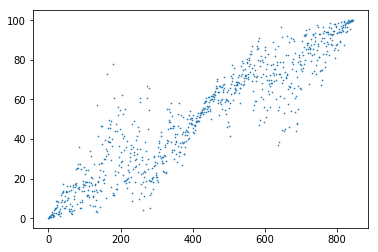

list_size = 909 BiHeapifyInwards() will be applied to:


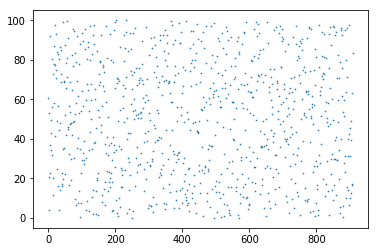

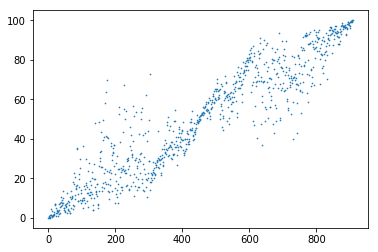

list_size = 974 BiHeapifyInwards() will be applied to:


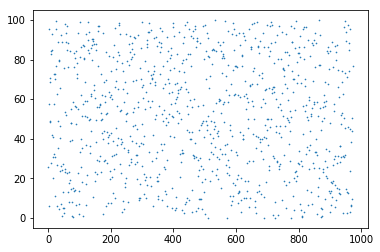

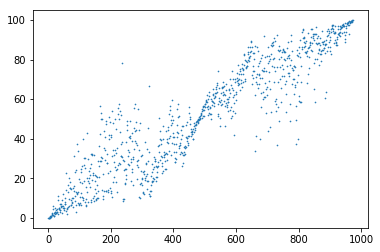

list_size = 1039 BiHeapifyInwards() will be applied to:


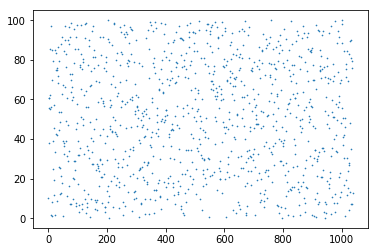

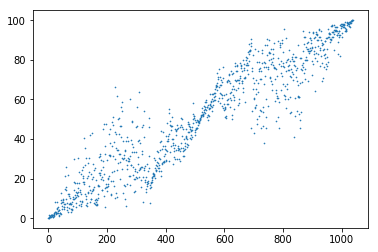

list_size = 1212 BiHeapifyInwards() will be applied to:


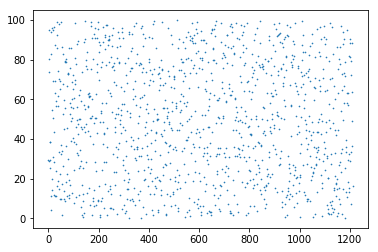

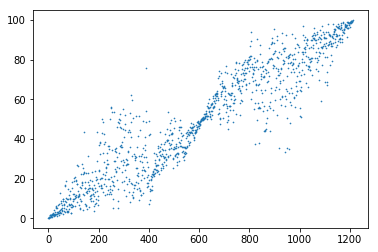

list_size = 1414 BiHeapifyInwards() will be applied to:


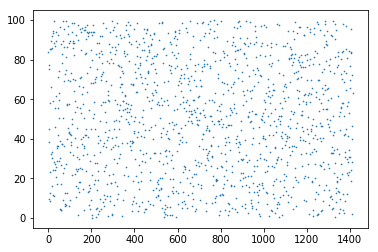

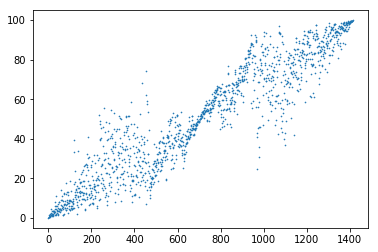

list_size = 1649 BiHeapifyInwards() will be applied to:


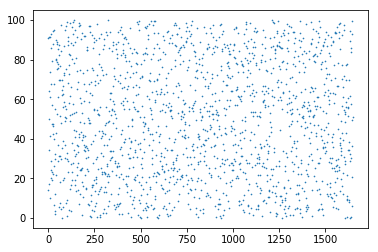

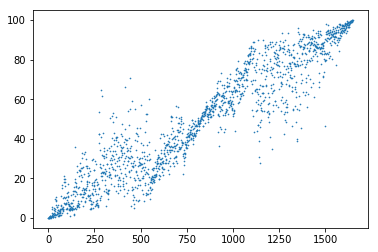

list_size = 1923 BiHeapifyInwards() will be applied to:


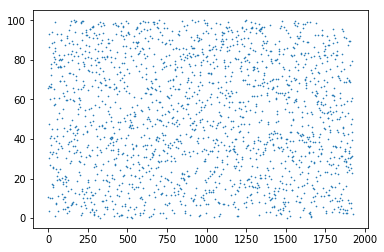

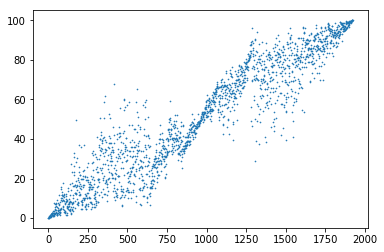

list_size = 2243 BiHeapifyInwards() will be applied to:


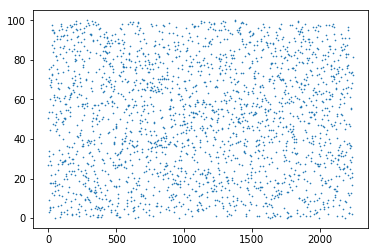

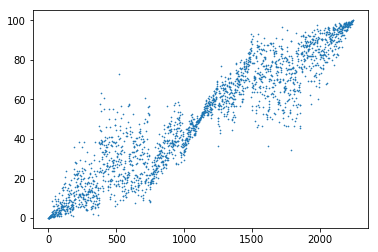

list_size = 2616 BiHeapifyInwards() will be applied to:


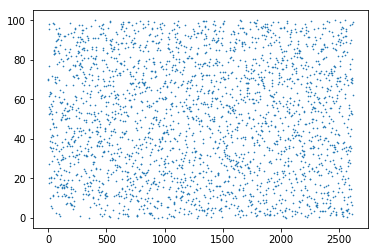

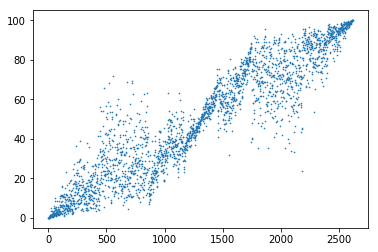

list_size = 3052 BiHeapifyInwards() will be applied to:


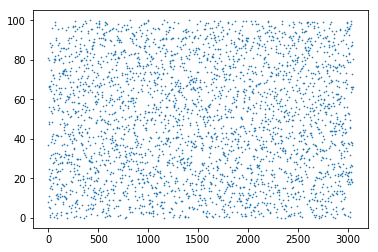

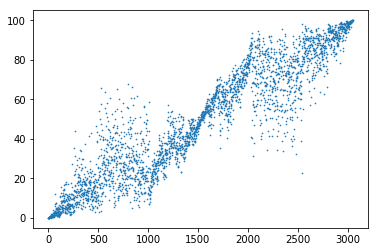

list_size = 3560 BiHeapifyInwards() will be applied to:


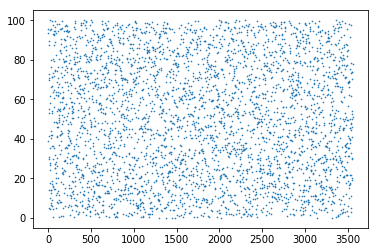

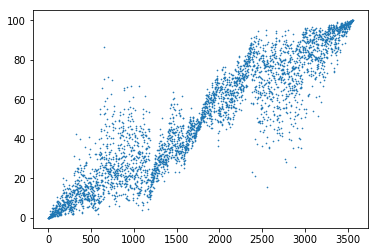

list_size = 4153 BiHeapifyInwards() will be applied to:


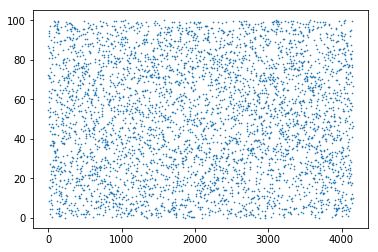

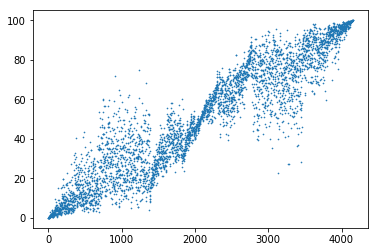

list_size = 4845 BiHeapifyInwards() will be applied to:


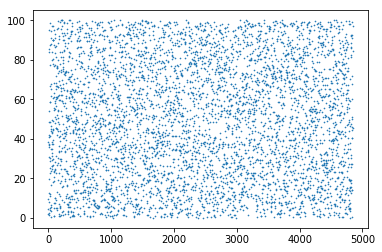

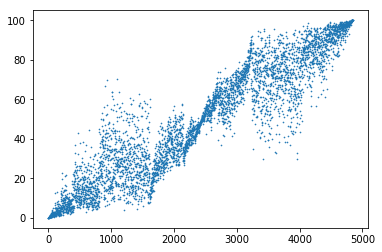

list_size = 5652 BiHeapifyInwards() will be applied to:


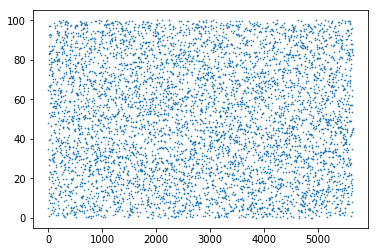

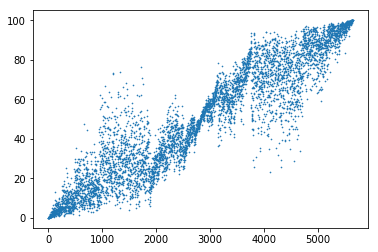

list_size = 6594 BiHeapifyInwards() will be applied to:


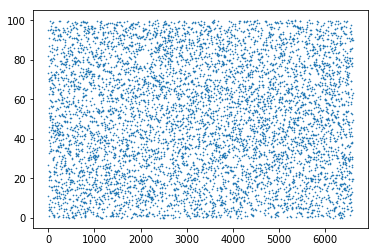

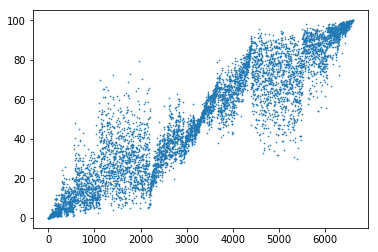

list_size = 7693 BiHeapifyInwards() will be applied to:


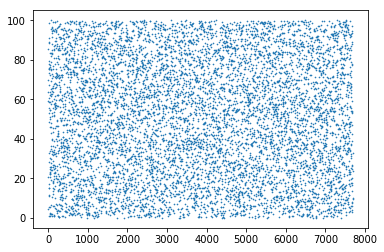

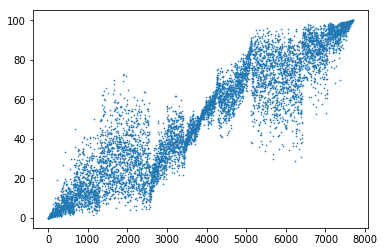

list_size = 8975 BiHeapifyInwards() will be applied to:


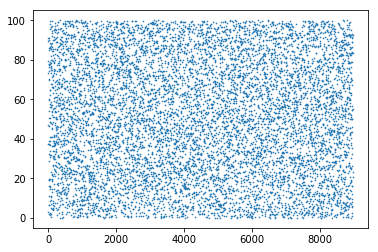

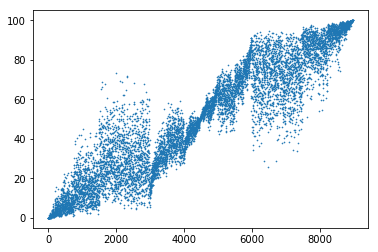

list_size = 10470 BiHeapifyInwards() will be applied to:


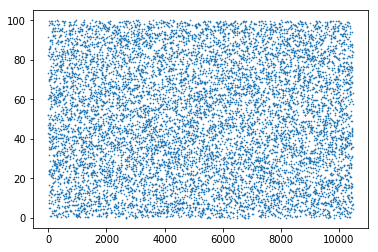

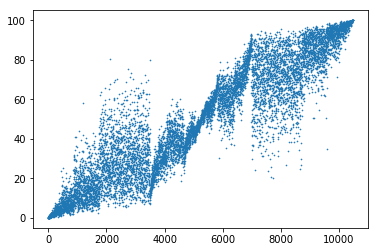

list_size = 12215 BiHeapifyInwards() will be applied to:


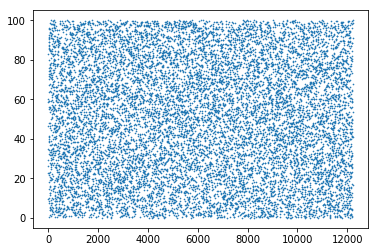

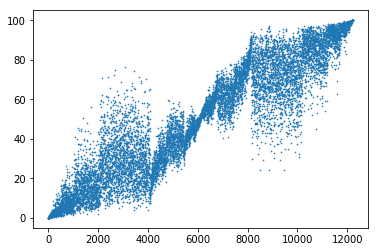

list_size = 14250 BiHeapifyInwards() will be applied to:


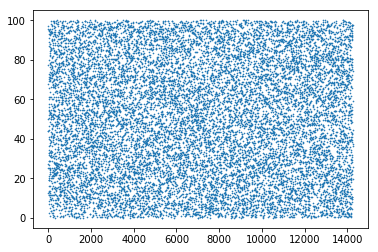

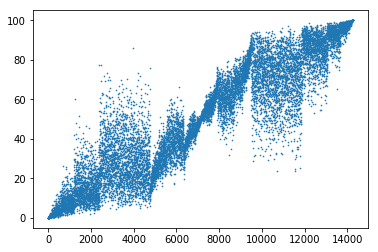

list_size = 16625 BiHeapifyInwards() will be applied to:


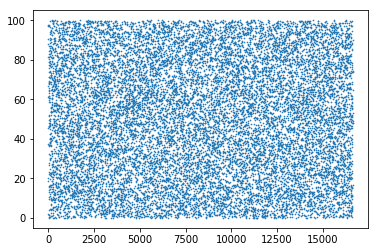

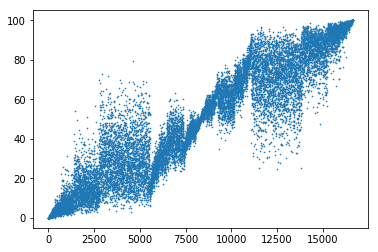

list_size = 19395 BiHeapifyInwards() will be applied to:


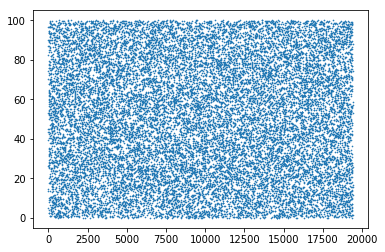

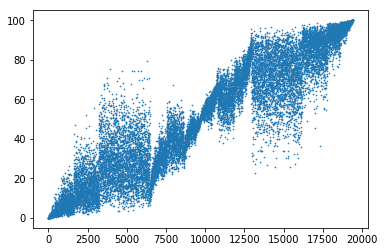

list_size = 22627 BiHeapifyInwards() will be applied to:


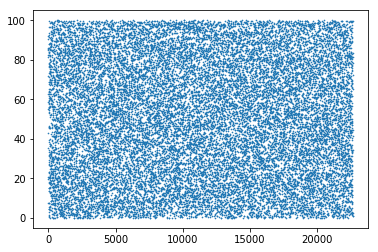

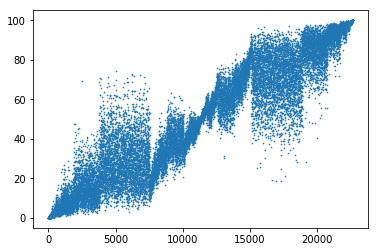

list_size = 26398 BiHeapifyInwards() will be applied to:


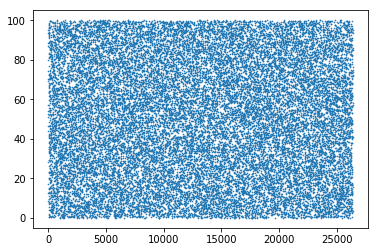

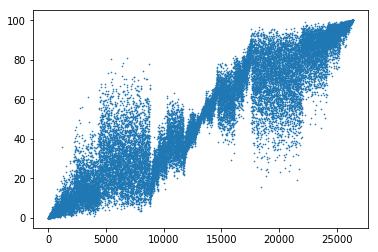

list_size = 30797 BiHeapifyInwards() will be applied to:


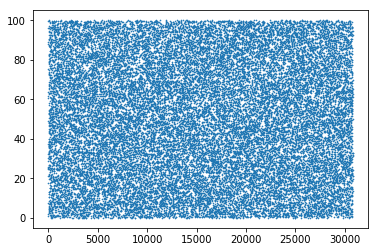

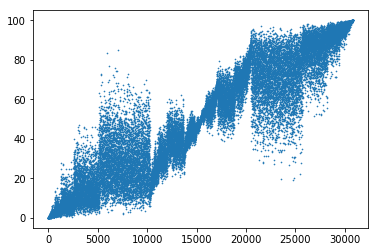

list_size = 35929 BiHeapifyInwards() will be applied to:


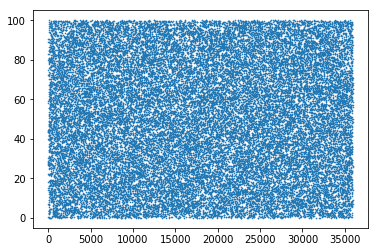

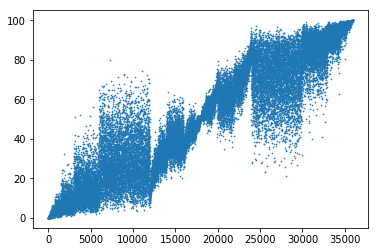

list_size = 41917 BiHeapifyInwards() will be applied to:


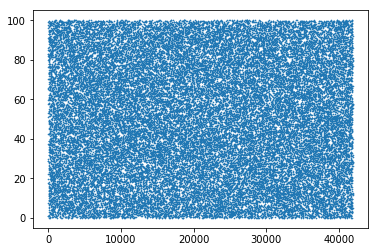

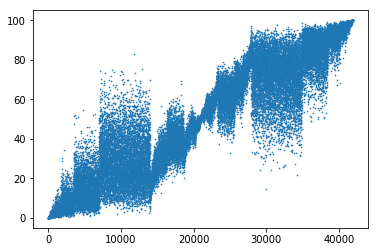

list_size = 48903 BiHeapifyInwards() will be applied to:


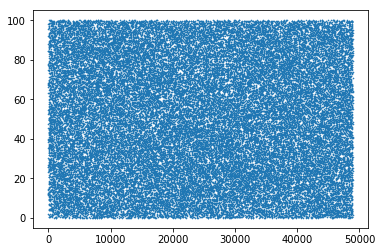

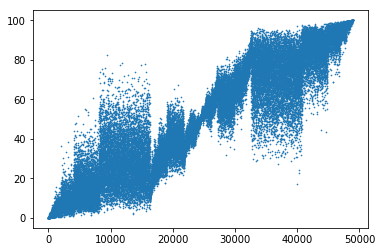

list_size = 57053 BiHeapifyInwards() will be applied to:


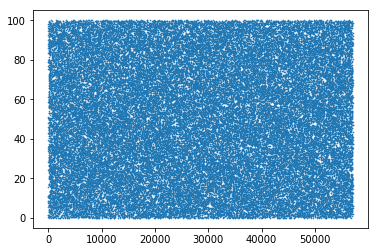

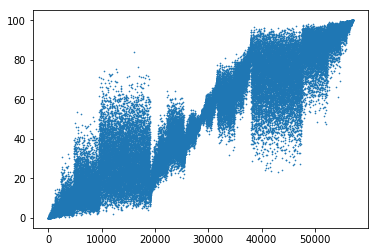

list_size = 66561 BiHeapifyInwards() will be applied to:


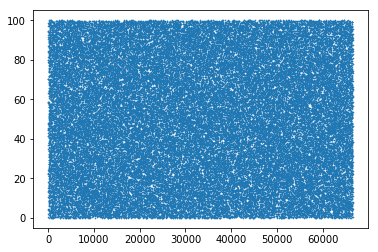

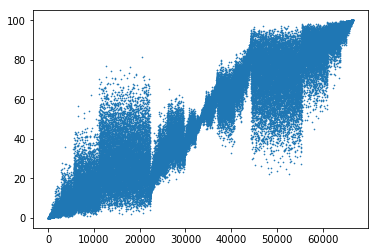

list_size = 77654 BiHeapifyInwards() will be applied to:


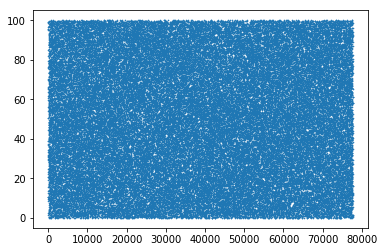

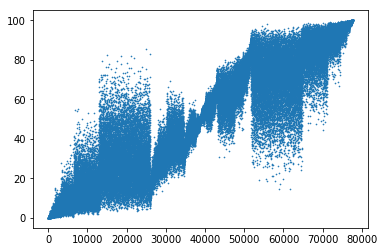

list_size = 90596 BiHeapifyInwards() will be applied to:


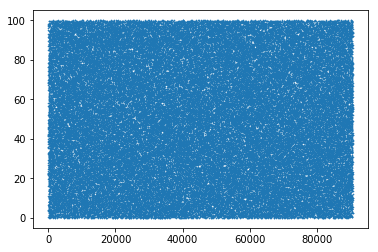

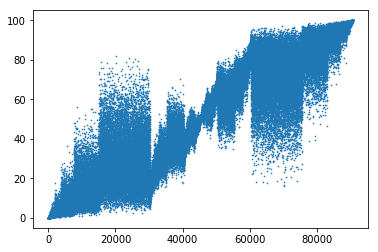

list_size = 105695 BiHeapifyInwards() will be applied to:


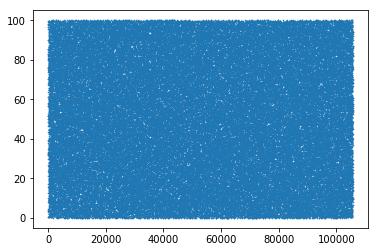

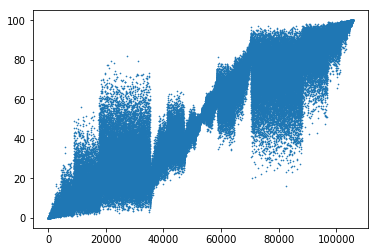

list_size = 123310 BiHeapifyInwards() will be applied to:


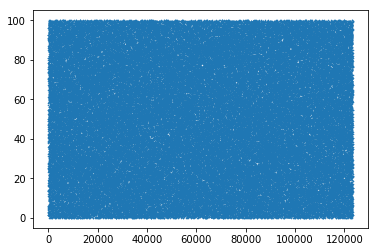

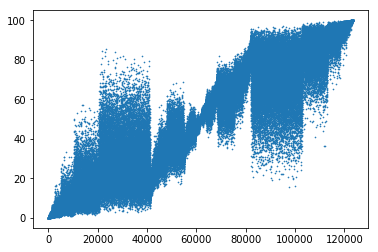

list_size = 143861 BiHeapifyInwards() will be applied to:


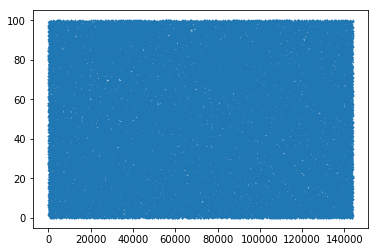

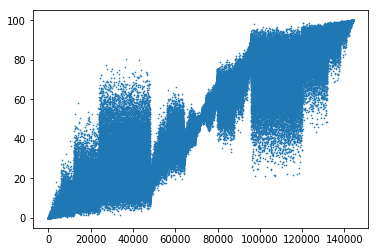

list_size = 167837 BiHeapifyInwards() will be applied to:


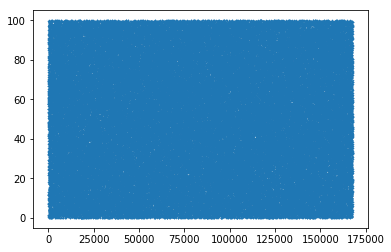

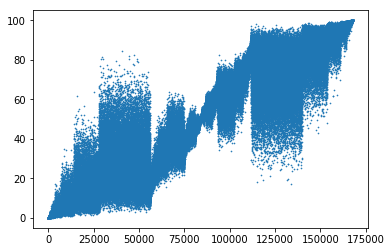

list_size = 195809 BiHeapifyInwards() will be applied to:


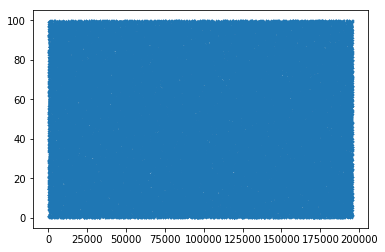

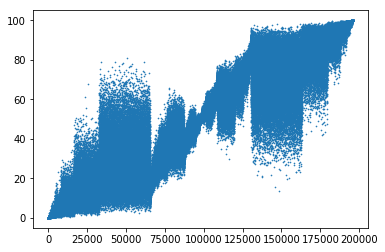

list_size = 228443 BiHeapifyInwards() will be applied to:


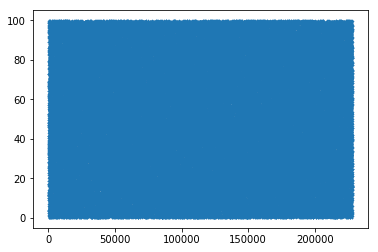

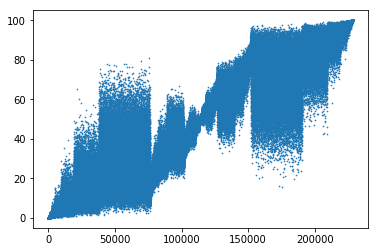

list_size = 266516 BiHeapifyInwards() will be applied to:


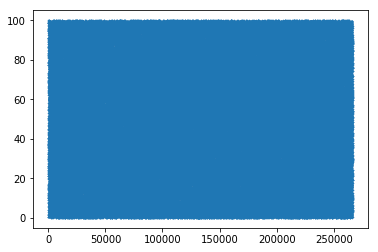

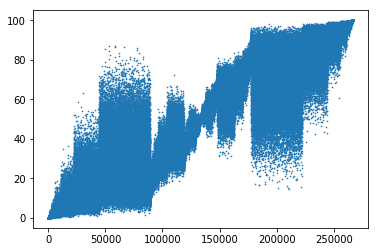

list_size = 310935 BiHeapifyInwards() will be applied to:


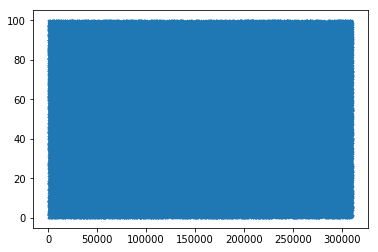

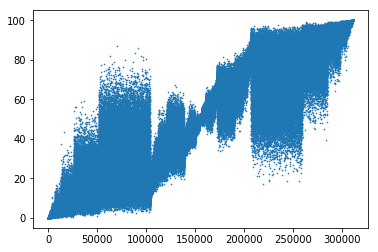

list_size = 362757 BiHeapifyInwards() will be applied to:


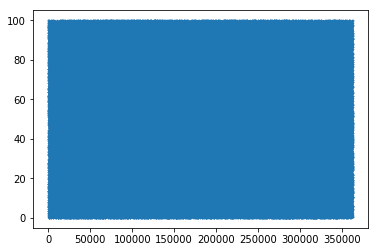

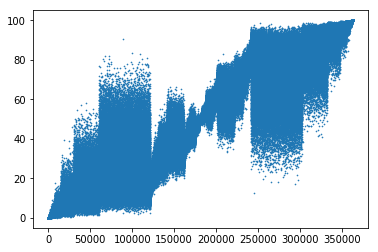

list_size = 423216 BiHeapifyInwards() will be applied to:


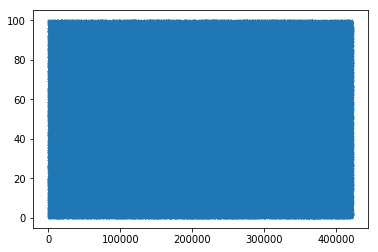

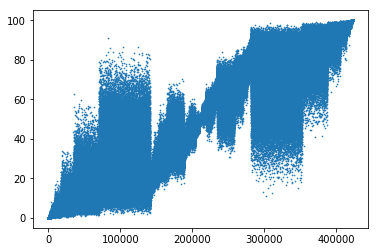

list_size = 493752 BiHeapifyInwards() will be applied to:


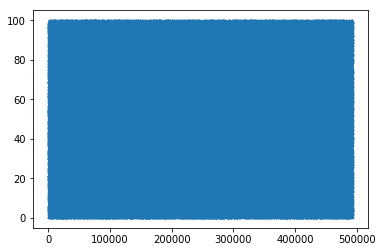

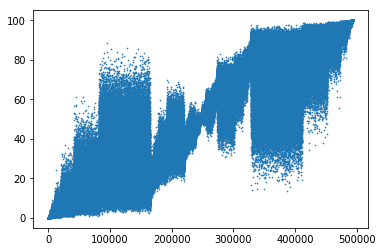

list_size = 576044 BiHeapifyInwards() will be applied to:


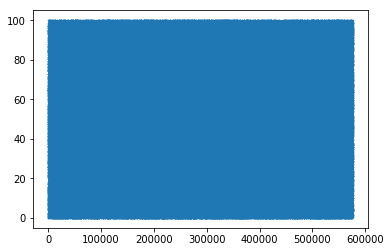

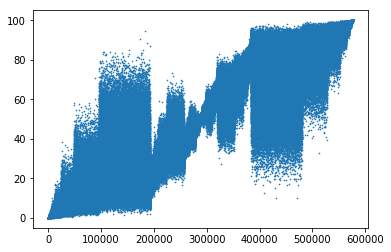

list_size = 672051 BiHeapifyInwards() will be applied to:


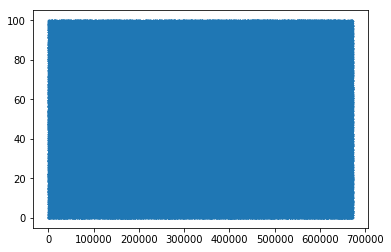

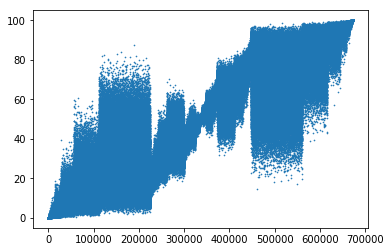

list_size = 784059 BiHeapifyInwards() will be applied to:


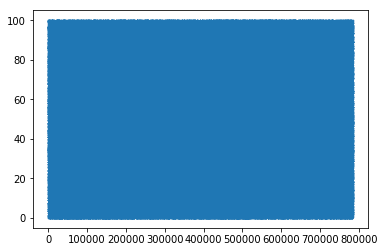

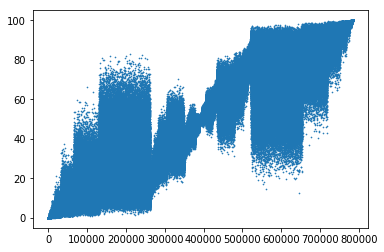

list_size = 914735 BiHeapifyInwards() will be applied to:


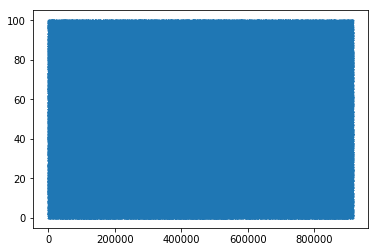

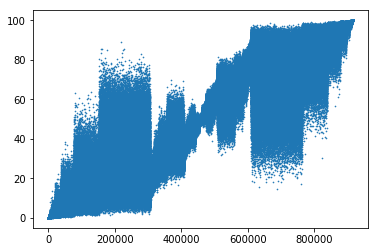

list_size = 1067190 BiHeapifyInwards() will be applied to:


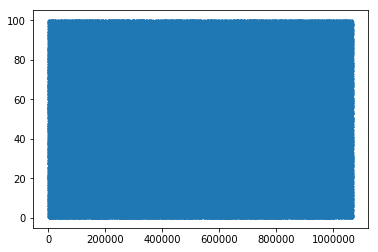

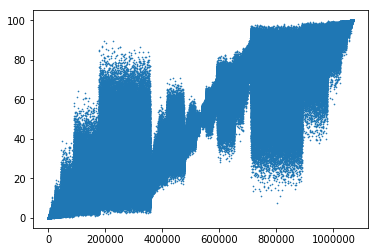

list_size = 1245055 BiHeapifyInwards() will be applied to:


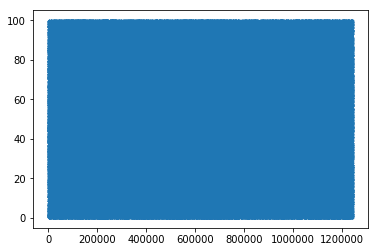

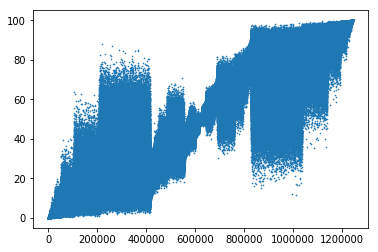

list_size = 1452564 BiHeapifyInwards() will be applied to:


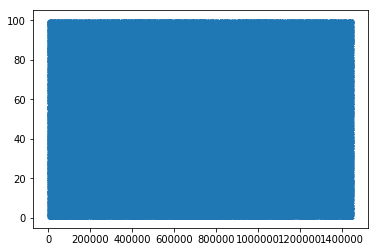

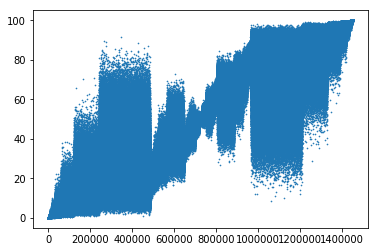

list_size = 1694658 BiHeapifyInwards() will be applied to:


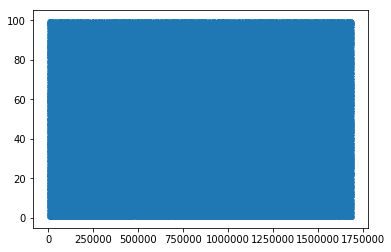

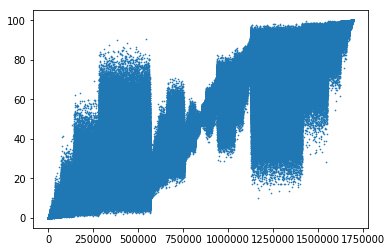

list_size = 1977101 BiHeapifyInwards() will be applied to:


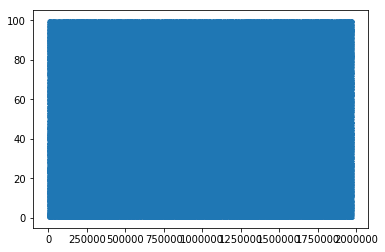

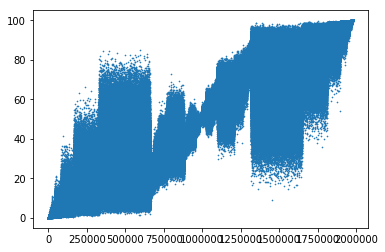

In [4]:
def BiHeapifyInwardsPlot():
    list_size_start = 2**6
    list_size_end = 2**21
    list_size_increment = 2**6 + 1
    list_size_start_exponential_growth_threshold = 2**10
    list_size_exponential_growth_divisor = 2^4
    list_size = list_size_start
    num_random_lists_per_vec_size = 2**0
    scale = 0.4
    while list_size <= list_size_end:
        ints_list = [x for x in range(list_size)]
        for _ in range(num_random_lists_per_vec_size):
            print('list_size =', list_size, 'BiHeapifyInwards() will be applied to:')
            li = [100 * random.random() for _ in range(list_size)]
            plt.scatter(ints_list, li, s = scale)
            plt.show()
            BiHeapifyInwards(li, list_size)
            plt.scatter(ints_list, li, s = scale)
            plt.show()
        if list_size >= list_size_start_exponential_growth_threshold:#If list_size should increase exponentially
            list_size += list_size // list_size_exponential_growth_divisor
        else:
            list_size += list_size_increment #Else increment list_size linearly.
    return 

BiHeapifyInwardsPlot()

list_size = 64 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


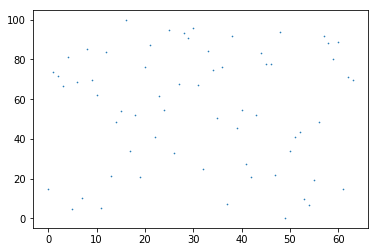

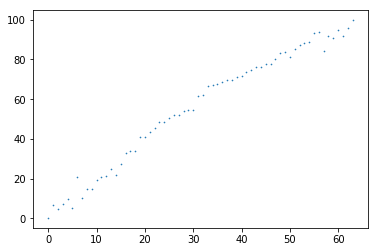

list_size = 129 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


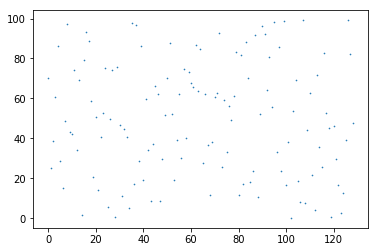

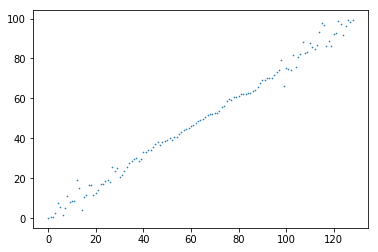

list_size = 194 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


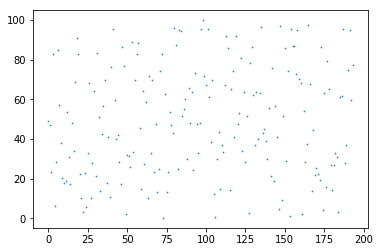

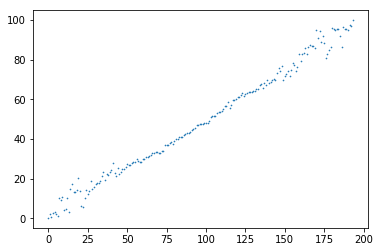

list_size = 259 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


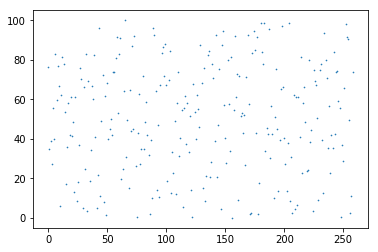

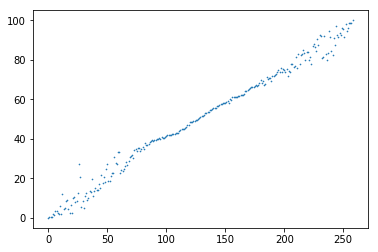

list_size = 324 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


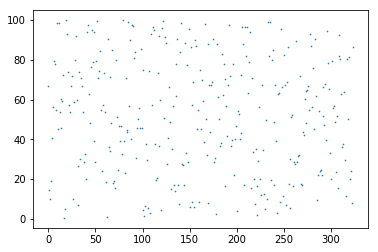

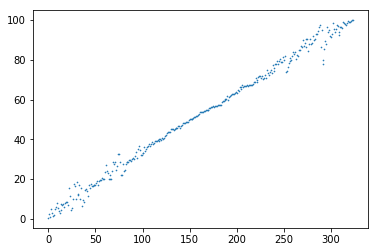

list_size = 389 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


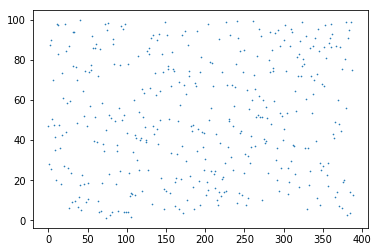

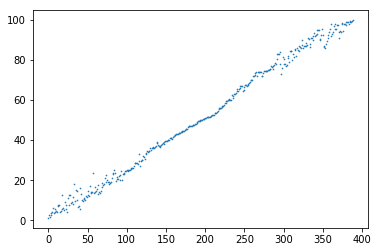

list_size = 454 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


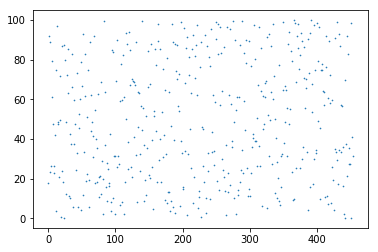

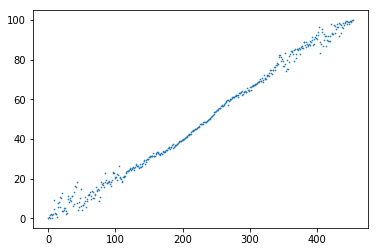

list_size = 519 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


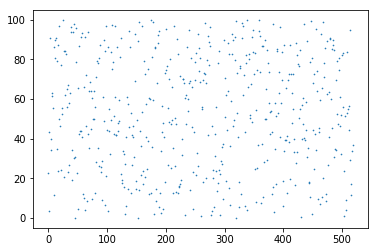

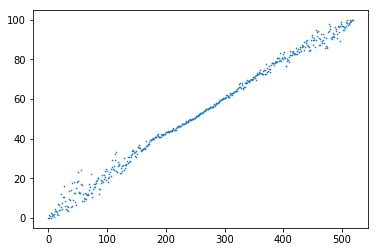

list_size = 584 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


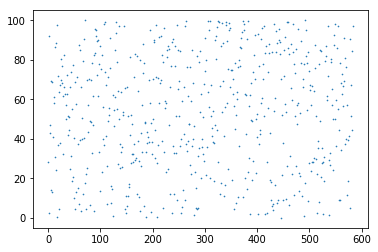

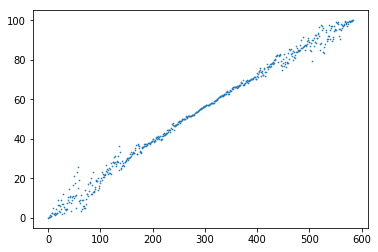

list_size = 649 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


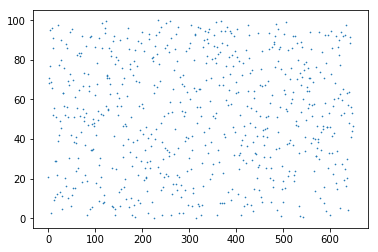

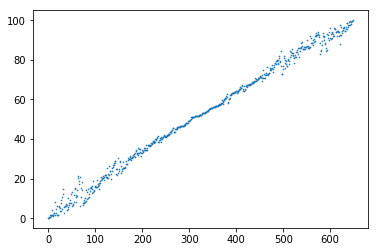

list_size = 714 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


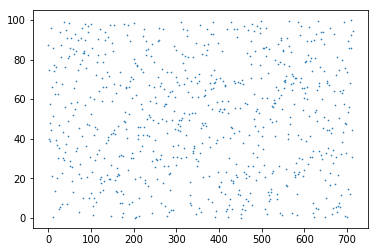

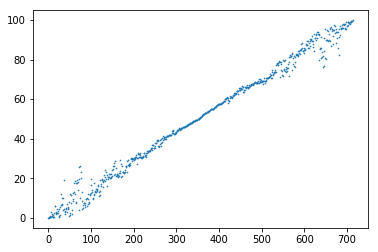

list_size = 779 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


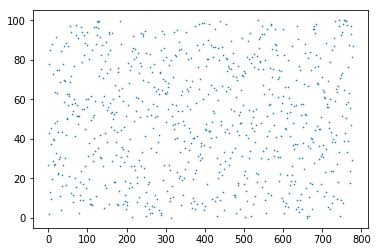

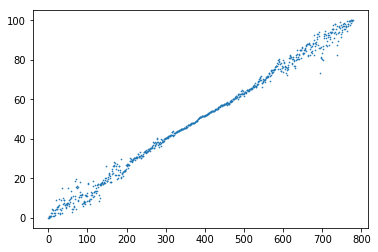

list_size = 844 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


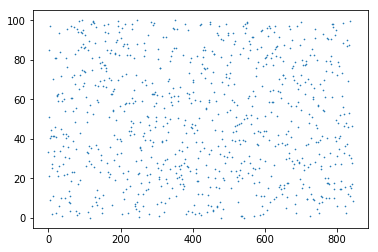

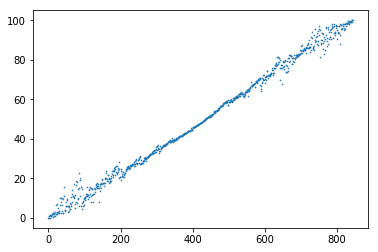

list_size = 909 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


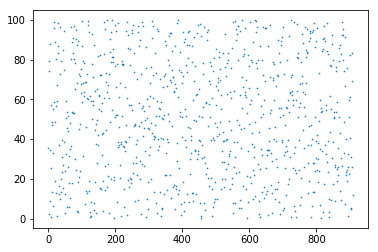

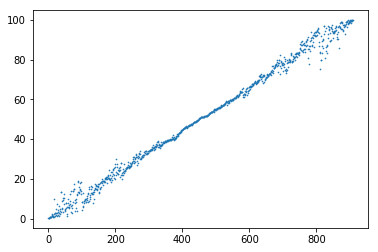

list_size = 974 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


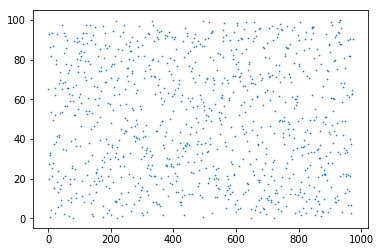

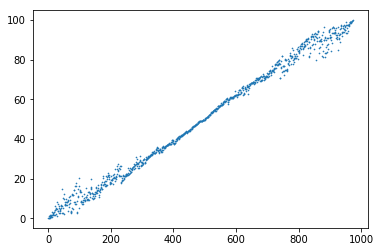

list_size = 1039 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


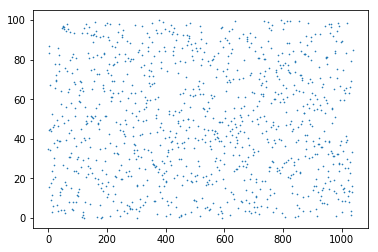

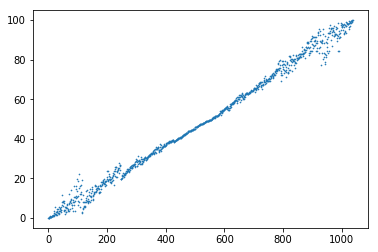

list_size = 1212 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


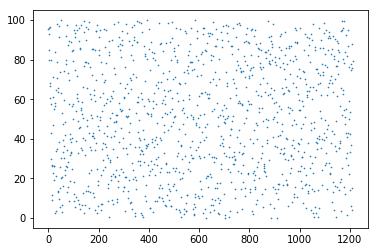

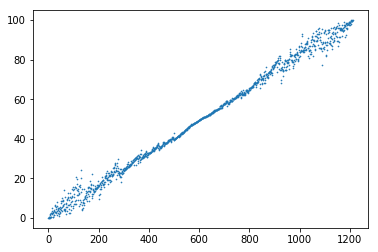

list_size = 1414 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


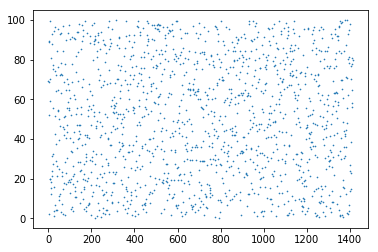

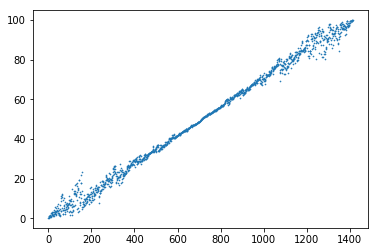

list_size = 1649 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


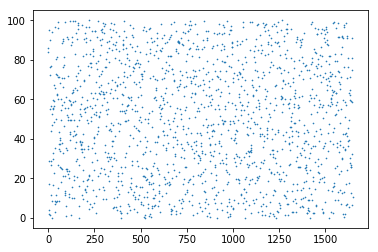

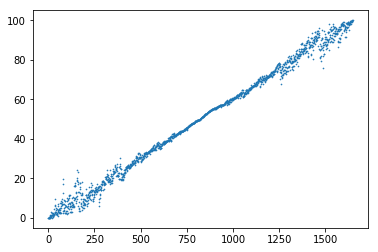

list_size = 1923 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


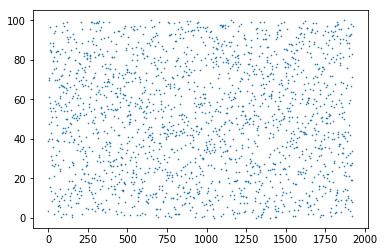

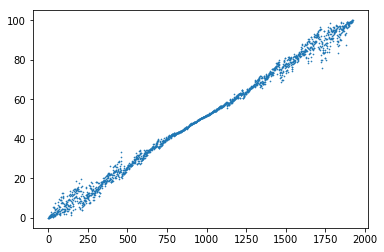

list_size = 2243 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


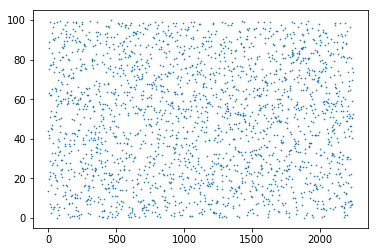

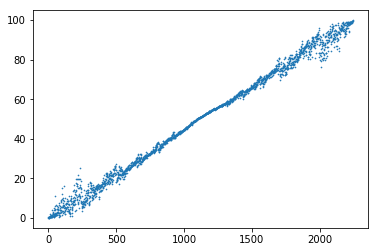

list_size = 2616 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


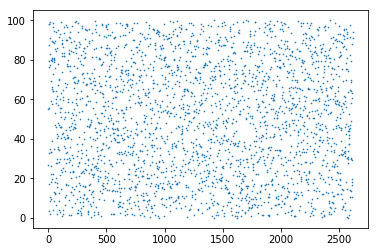

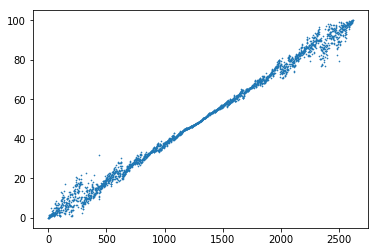

list_size = 3052 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


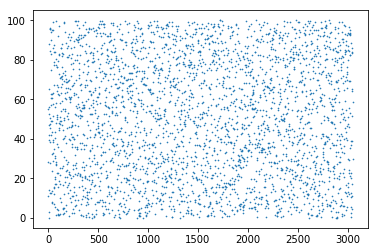

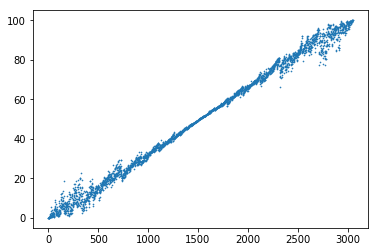

list_size = 3560 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


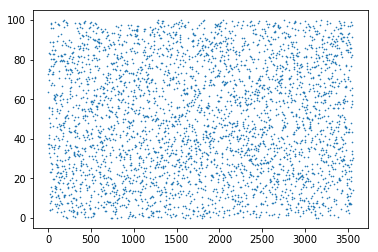

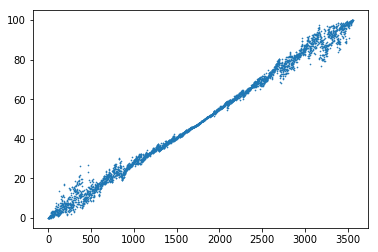

list_size = 4153 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


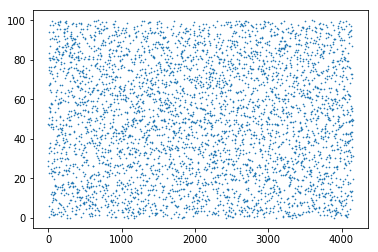

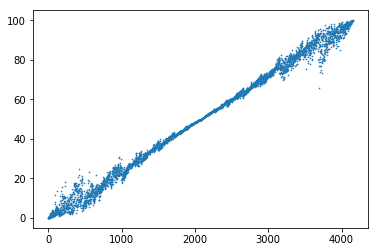

list_size = 4845 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


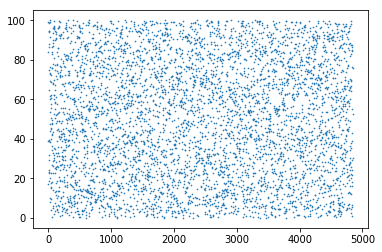

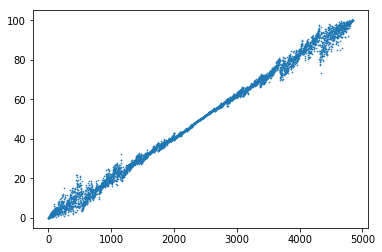

list_size = 5652 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


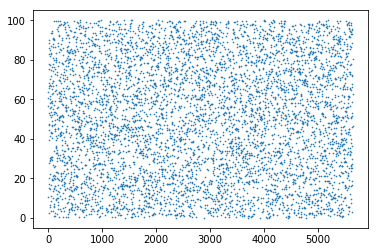

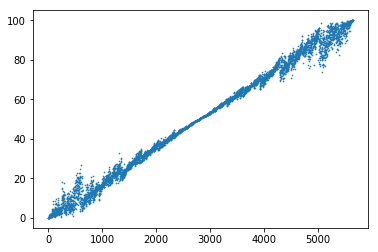

list_size = 6594 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


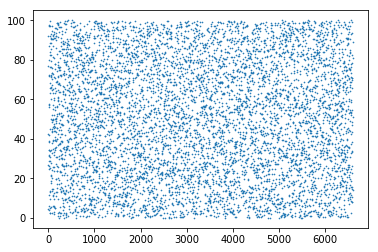

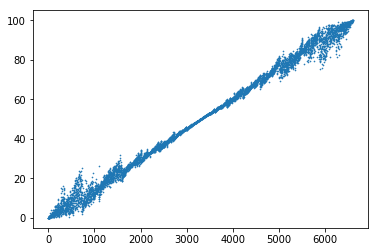

list_size = 7693 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


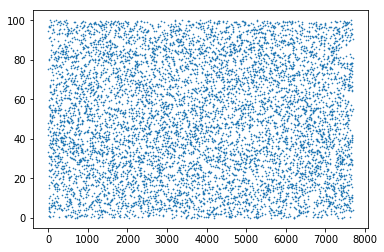

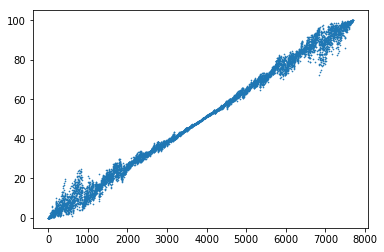

list_size = 8975 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


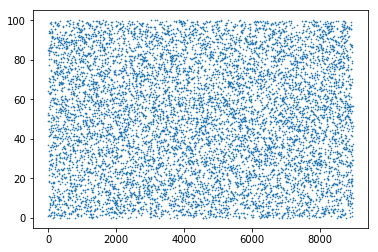

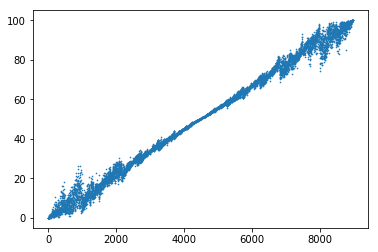

list_size = 10470 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


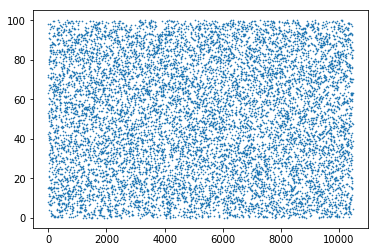

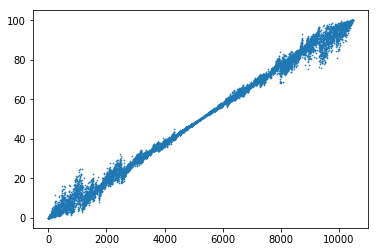

list_size = 12215 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


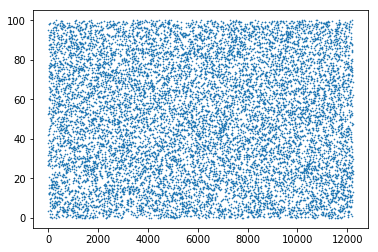

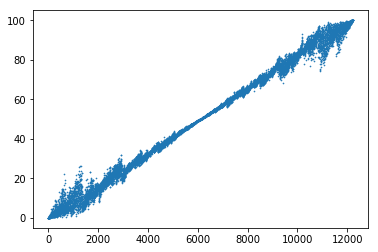

list_size = 14250 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


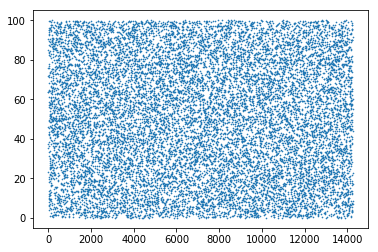

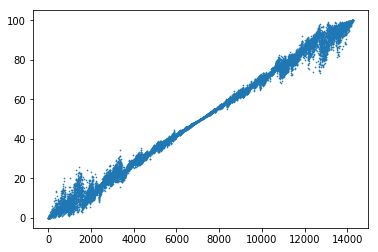

list_size = 16625 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


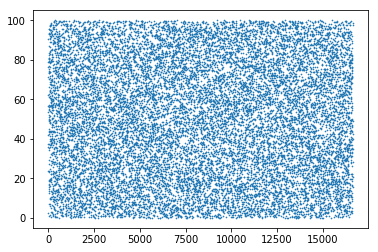

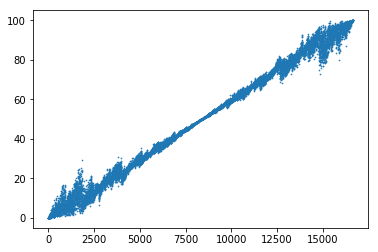

list_size = 19395 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


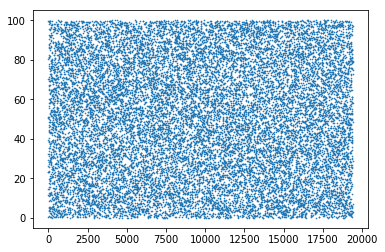

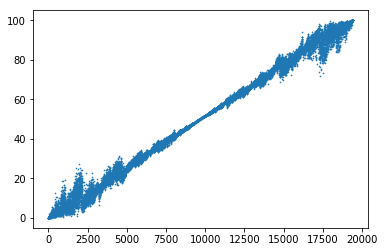

list_size = 22627 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


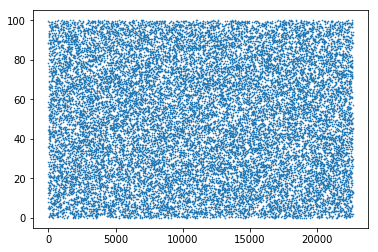

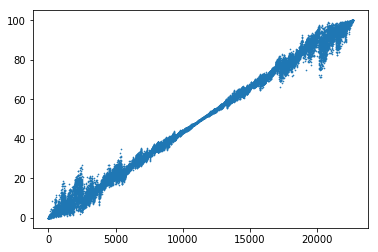

list_size = 26398 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


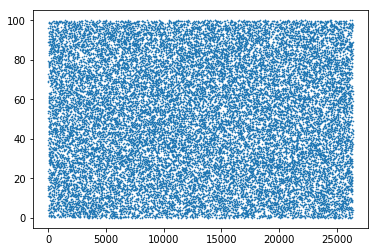

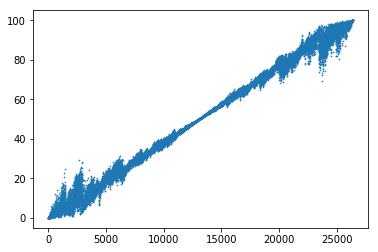

list_size = 30797 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


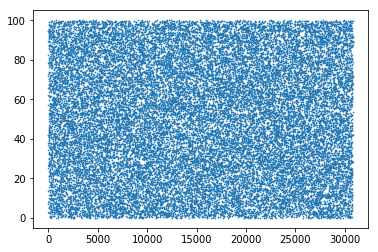

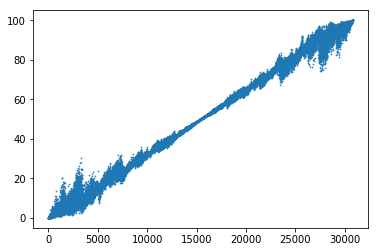

list_size = 35929 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


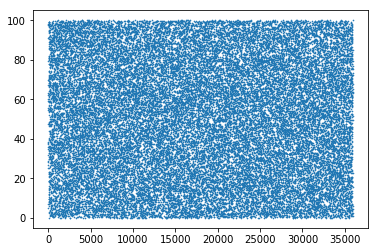

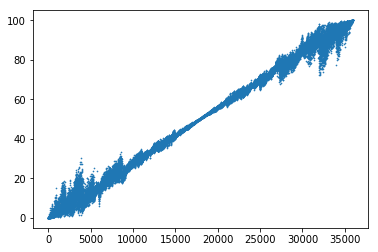

list_size = 41917 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


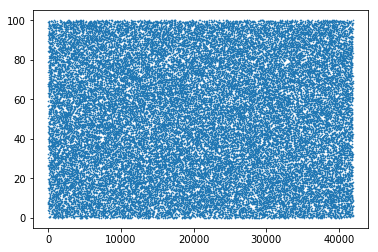

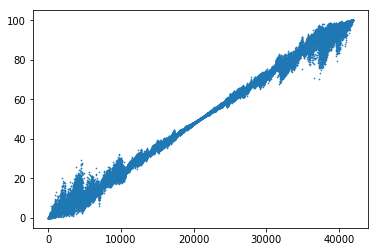

list_size = 48903 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


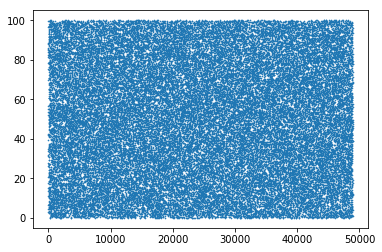

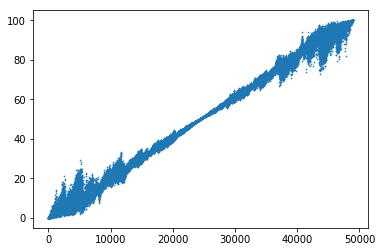

list_size = 57053 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


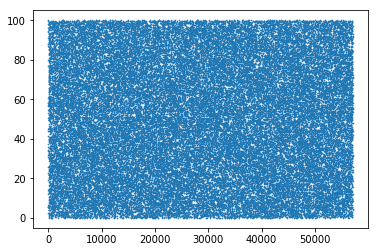

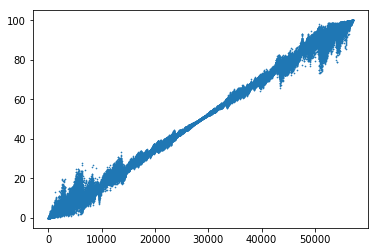

list_size = 66561 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


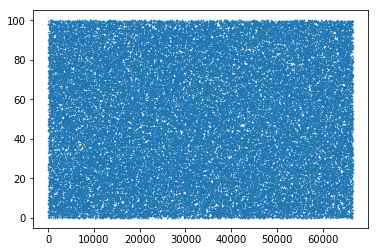

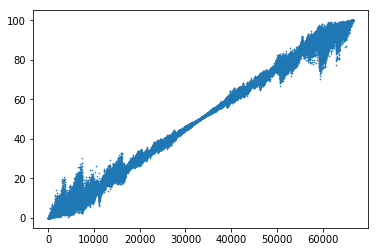

list_size = 77654 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


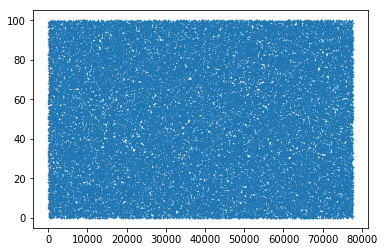

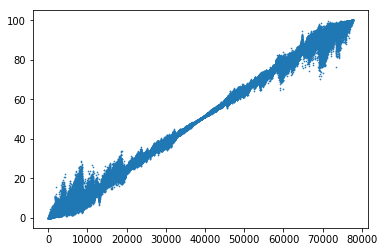

list_size = 90596 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


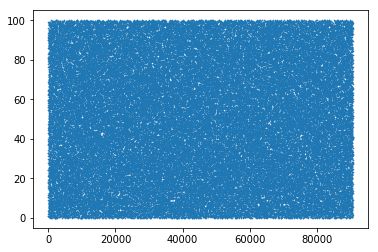

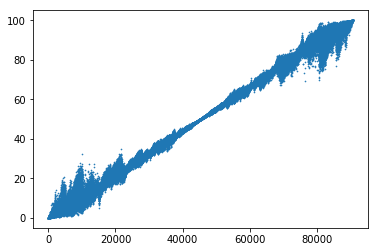

list_size = 105695 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


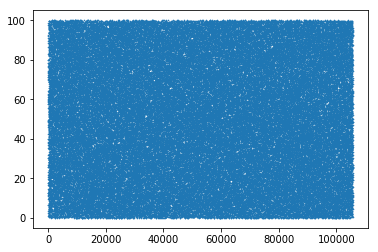

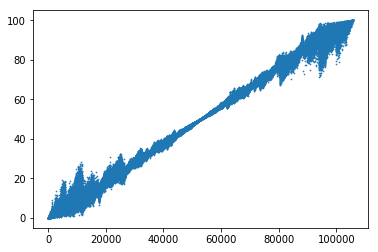

list_size = 123310 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


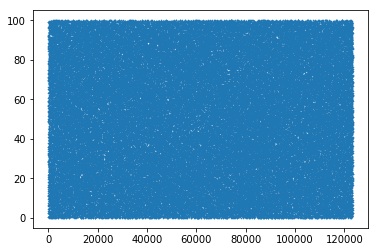

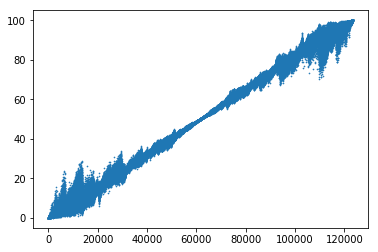

list_size = 143861 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


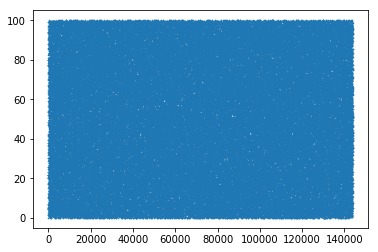

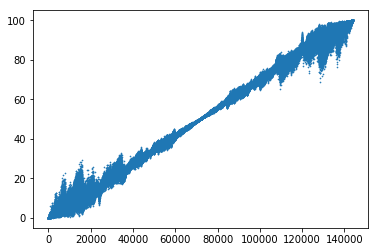

list_size = 167837 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


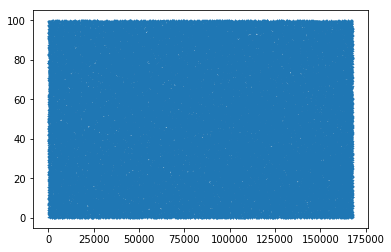

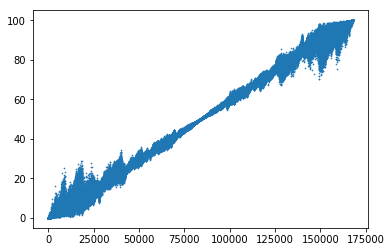

list_size = 195809 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


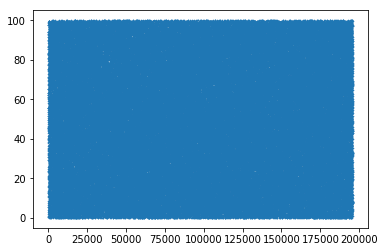

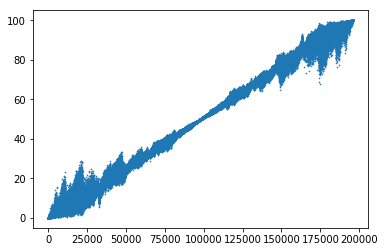

list_size = 228443 BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:


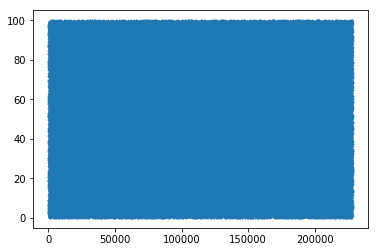

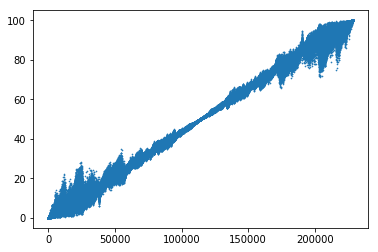

In [5]:
def StrongBiHeapifyWithOffset(li, start_offset, total_num_nodes):
    BiHeapifyWithOffset(li, start_offset, total_num_nodes)
    num_nodes_in_heap                = HeapSize(total_num_nodes)
    first_extended_in_node           = total_num_nodes - num_nodes_in_heap
    BiHeapifyInwardsWithOffset(li, start_offset, first_extended_in_node)
    BiHeapifyInwardsWithOffset(li, start_offset + first_extended_in_node, num_nodes_in_heap - first_extended_in_node)
    BiHeapifyInwardsWithOffset(li, start_offset + num_nodes_in_heap, first_extended_in_node)
    pure_heap_size = (total_num_nodes + 1) // 2
    BiHeapifyWithOffset(li, start_offset, pure_heap_size)
    BiHeapifyWithOffset(li, start_offset + (total_num_nodes // 2), pure_heap_size)
    parent_of_last_pure_node = GetParentNotRoot(pure_heap_size - 1)
    first_pure_leaf = parent_of_last_pure_node + 1
    #BiHeapifyWithOffset(li, start_offset + first_pure_leaf, total_num_nodes - 2 * first_pure_leaf)
    BiHeapifyWithOffset(li, start_offset, total_num_nodes)
    return

def StrongBiHeapifyInwardsWithOffset(li, start_offset, total_num_nodes):
    BiHeapifyInwardsWithOffset(li, start_offset, total_num_nodes)
    num_nodes_in_heap                = HeapSize(total_num_nodes)
    first_extended_in_node           = total_num_nodes - num_nodes_in_heap
    BiHeapifyInwardsWithOffset(li, start_offset, first_extended_in_node)
    BiHeapifyInwardsWithOffset(li, start_offset + first_extended_in_node, num_nodes_in_heap - first_extended_in_node)
    BiHeapifyInwardsWithOffset(li, start_offset + num_nodes_in_heap, first_extended_in_node)
    pure_heap_size = (total_num_nodes + 1) // 2
    BiHeapifyInwardsWithOffset(li, start_offset, pure_heap_size)
    BiHeapifyInwardsWithOffset(li, start_offset + (total_num_nodes // 2), pure_heap_size)
    parent_of_last_pure_node = GetParentNotRoot(pure_heap_size - 1)
    first_pure_leaf = parent_of_last_pure_node + 1
    #BiHeapifyInwardsWithOffset(li, start_offset + first_pure_leaf, total_num_nodes - 2 * first_pure_leaf)
    BiHeapifyInwardsWithOffset(li, start_offset, total_num_nodes)
    BiHeapifyWithOffset(li, start_offset, total_num_nodes)
    return

def MultipleStrongBiHeapifiesSymmetrcAboutMiddle(li, start_offset, total_num_nodes, offsets):
    offsets.sort()
    for i in offsets:
        if 2 * i >= total_num_nodes:
            continue
        StrongBiHeapifyWithOffset(li, start_offset + i, total_num_nodes - 2 * i)
    return 

def MultipleStrongBiHeapifiesInwardsSymmetrcAboutMiddle(li, start_offset, total_num_nodes, offsets):
    offsets.sort()
    for i in offsets:
        if 2 * i >= total_num_nodes:
            continue
        StrongBiHeapifyWithOffset(li, start_offset + i, total_num_nodes - 2 * i)
    return 

def BiHeapifyInwardsMedianApproximationAndPartitionWithOffset(li, start_offset, total_num_nodes):
    while total_num_nodes > 7:
        num_nodes_in_heap                = HeapSize(total_num_nodes)
        first_extended_in_node           = total_num_nodes - num_nodes_in_heap
        parent_of_first_extended_in_node = GetParentNotRoot(first_extended_in_node)
        last_node_in_pure_min_heap       = (total_num_nodes - 1) // 2
        parent_of_last_node_in_pure_min_heap = GetParentNotRoot(last_node_in_pure_min_heap)
        first_pure_leaf = parent_of_last_node_in_pure_min_heap + 1
        offsets = [0, parent_of_first_extended_in_node, parent_of_last_node_in_pure_min_heap, first_pure_leaf]
        MultipleStrongBiHeapifiesSymmetrcAboutMiddle(li, start_offset, total_num_nodes, offsets)
        #MultipleStrongBiHeapifiesInwardsSymmetrcAboutMiddle(li, start_offset, total_num_nodes, offsets)
        start_offset                     = start_offset + first_extended_in_node
        total_num_nodes                  = num_nodes_in_heap - first_extended_in_node
    if total_num_nodes > 1:
          li[start_offset:start_offset + total_num_nodes] = sorted(li[start_offset:start_offset + total_num_nodes])
    return

#Note how the above O(total_num_nodes) function "approximately almost sorts" each list.
def BiHeapifyInwardsMedianApproximationAndPartitionPlot():
    list_size_start = 2**6
    list_size_end = 2**18
    list_size_increment = 2**6 + 1
    list_size_start_exponential_growth_threshold = 2**10
    list_size_exponential_growth_divisor = 2^4
    list_size = list_size_start
    num_random_lists_per_vec_size = 2**0
    scale = 0.4
    while list_size <= list_size_end:
        ints_list = [x for x in range(list_size)]
        for _ in range(num_random_lists_per_vec_size):
            print('list_size =', list_size, 'BiHeapifyInwardsMedianApproximationAndPartitionWithOffset() will be applied to:')
            li = [100 * random.random() for _ in range(list_size)]
            plt.scatter(ints_list, li, s = scale)
            plt.show()
            BiHeapifyInwardsMedianApproximationAndPartitionWithOffset(li, 0, list_size)
            plt.scatter(ints_list, li, s = scale)
            plt.show()
        if list_size >= list_size_start_exponential_growth_threshold:#If list_size should increase exponentially
            list_size += list_size // list_size_exponential_growth_divisor
        else:
            list_size += list_size_increment #Else increment list_size linearly.
    return 

BiHeapifyInwardsMedianApproximationAndPartitionPlot()


list_size = 64 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


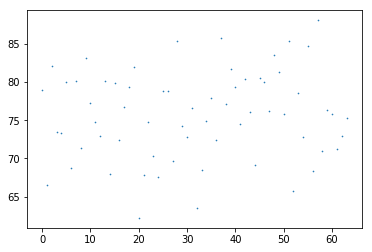

desired_offset = 0


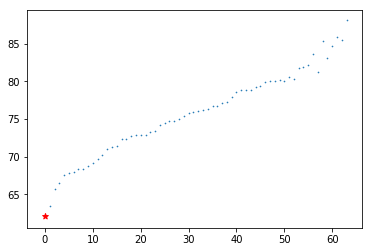

list_size = 129 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


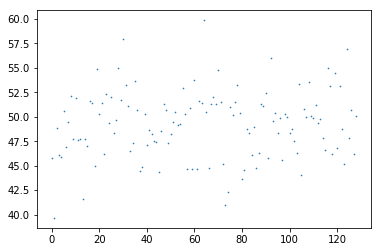

desired_offset = 114


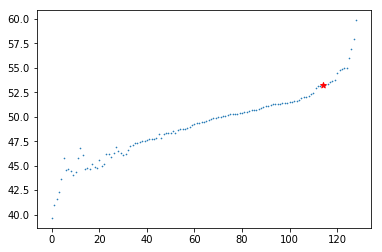

list_size = 194 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


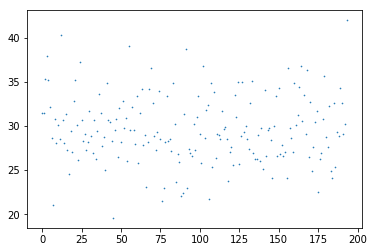

desired_offset = 48


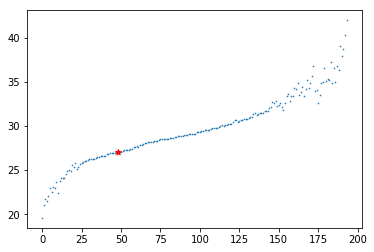

list_size = 259 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


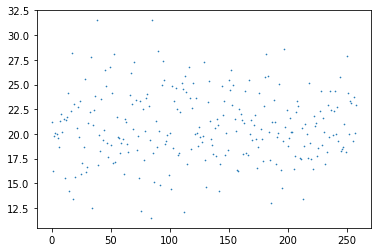

desired_offset = 92


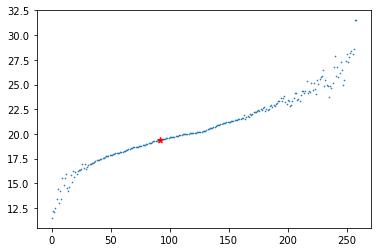

list_size = 324 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


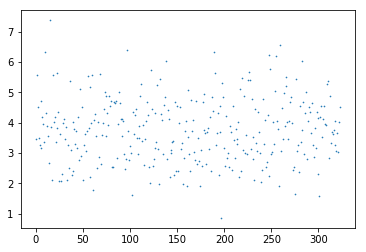

desired_offset = 31


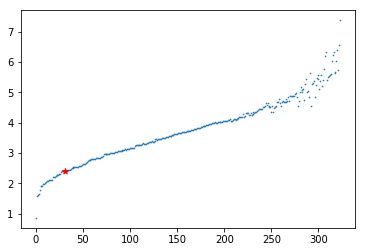

list_size = 389 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


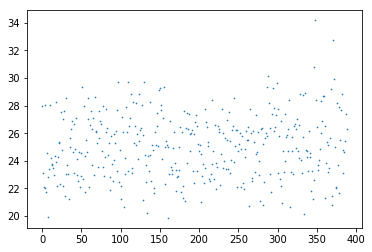

desired_offset = 135


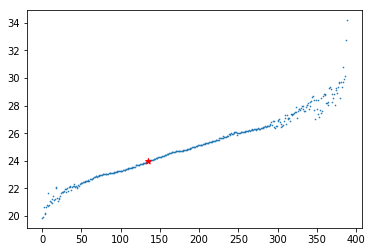

list_size = 454 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


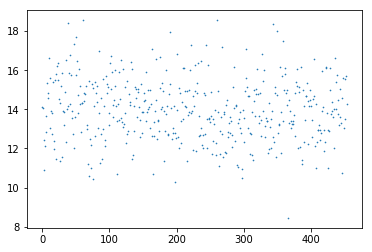

desired_offset = 40


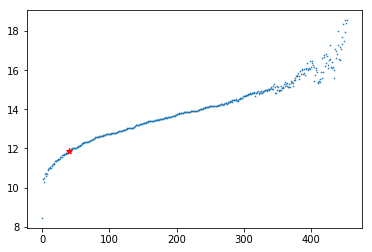

list_size = 519 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


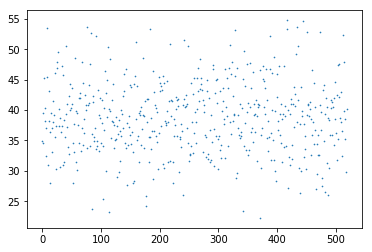

desired_offset = 64


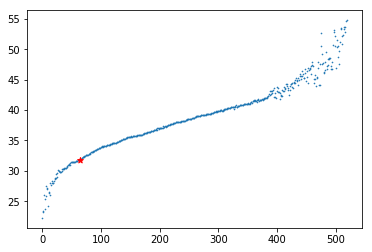

list_size = 584 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


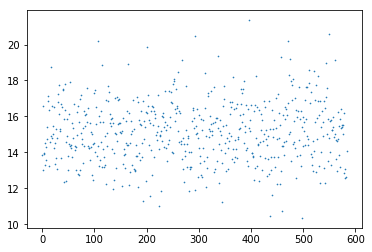

desired_offset = 470


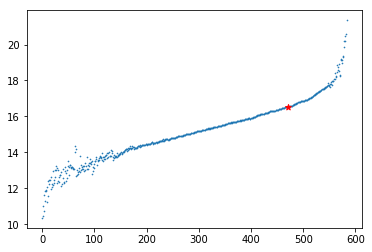

list_size = 649 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


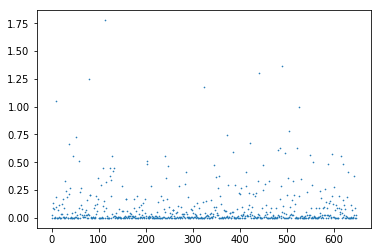

desired_offset = 35


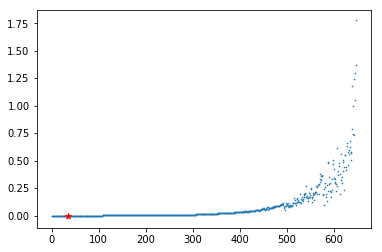

list_size = 714 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


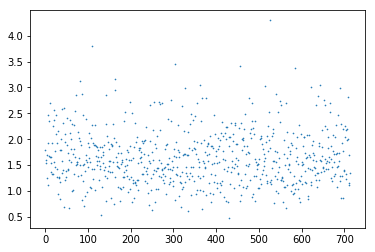

desired_offset = 4


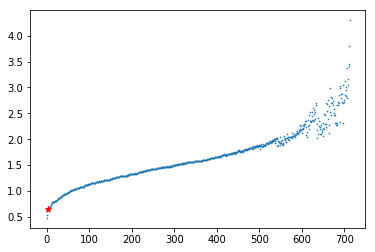

list_size = 779 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


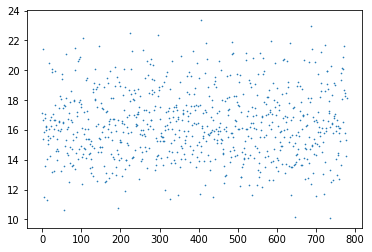

desired_offset = 228


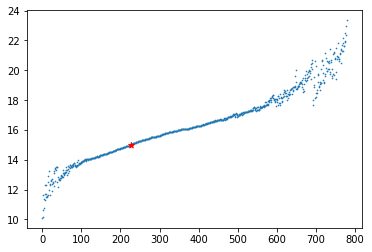

list_size = 844 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


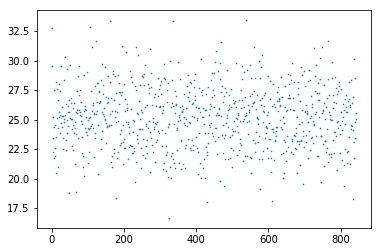

desired_offset = 552


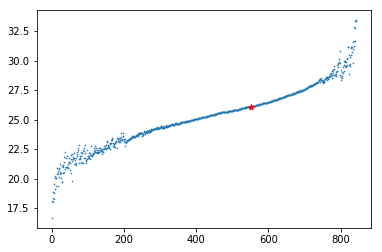

list_size = 909 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


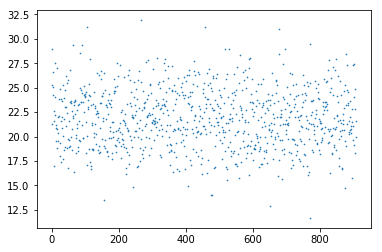

desired_offset = 548


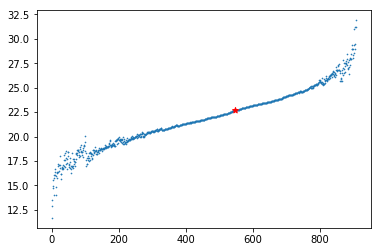

list_size = 974 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


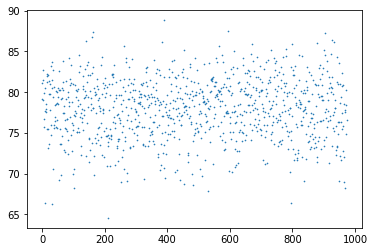

desired_offset = 950


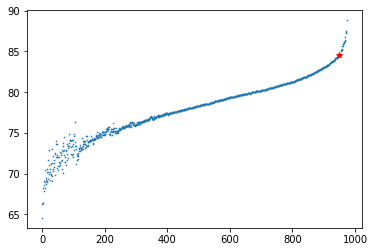

list_size = 1039 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


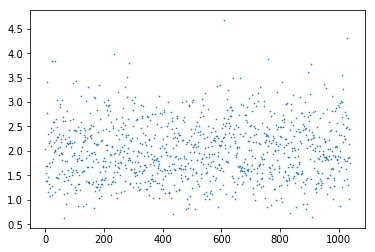

desired_offset = 751


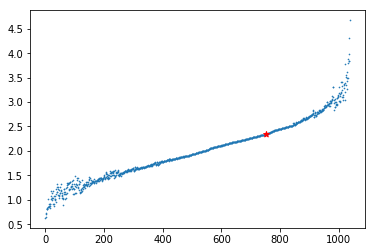

list_size = 1212 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


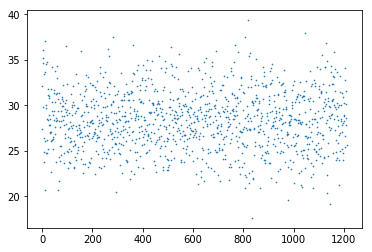

desired_offset = 106


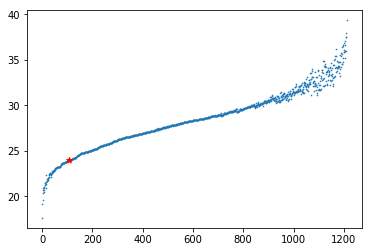

list_size = 1414 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


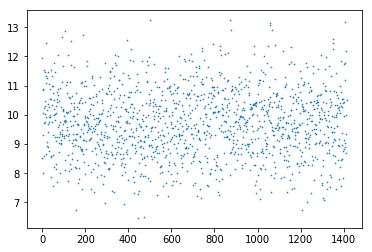

desired_offset = 992


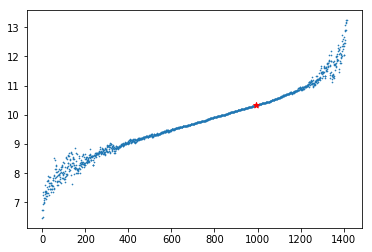

list_size = 1649 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


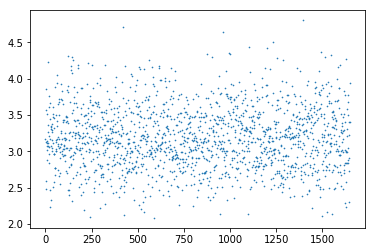

desired_offset = 616


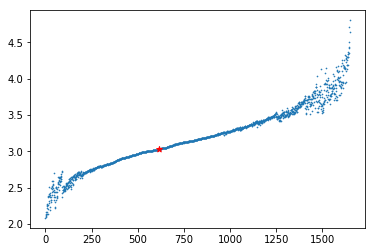

list_size = 1923 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


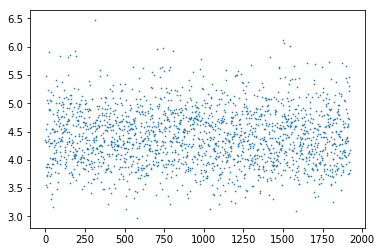

desired_offset = 1444


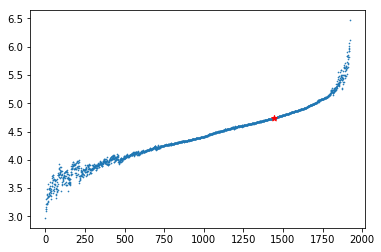

list_size = 2243 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


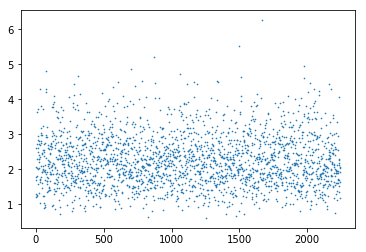

desired_offset = 1395


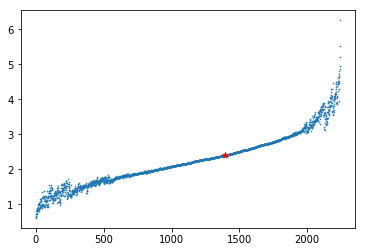

list_size = 2616 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


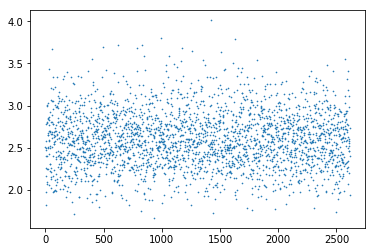

desired_offset = 1591


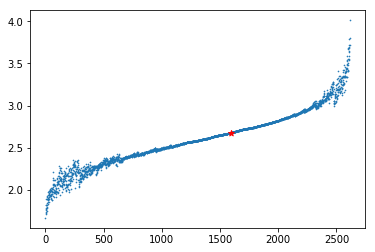

list_size = 3052 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


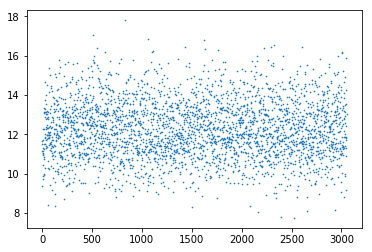

desired_offset = 2139


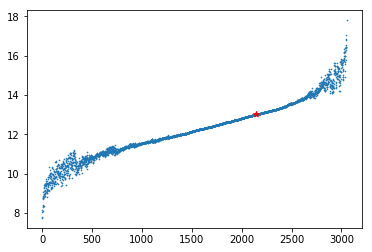

list_size = 3560 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


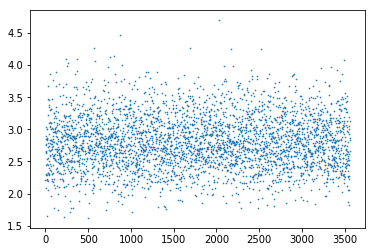

desired_offset = 222


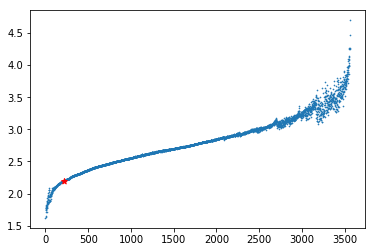

list_size = 4153 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


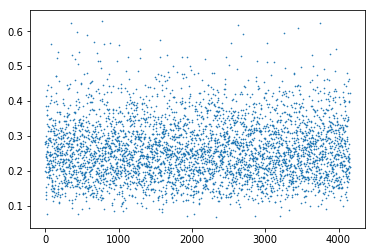

desired_offset = 3381


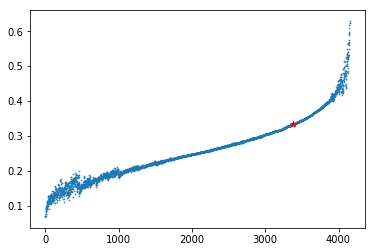

list_size = 4845 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


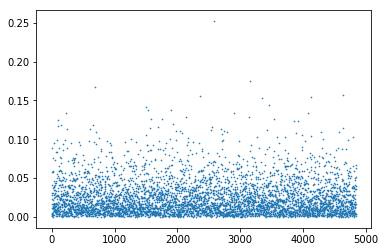

desired_offset = 2399


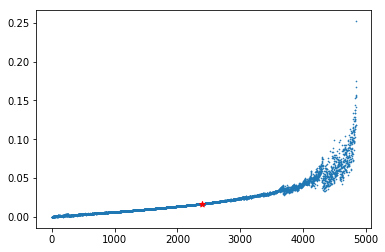

list_size = 5652 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


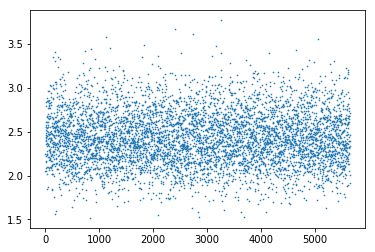

desired_offset = 2485


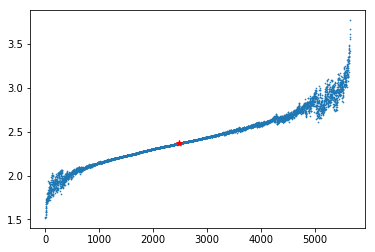

list_size = 6594 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


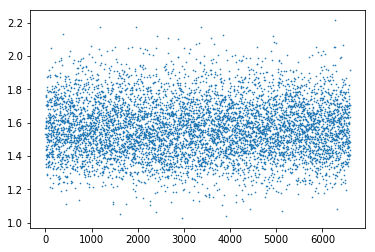

desired_offset = 428


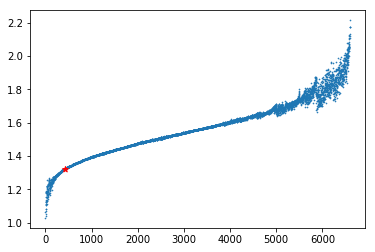

list_size = 7693 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


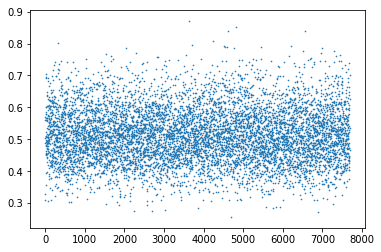

desired_offset = 6983


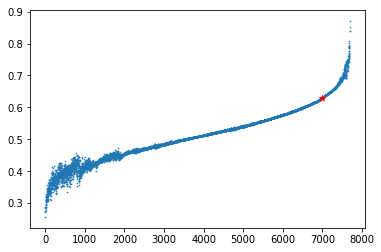

list_size = 8975 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


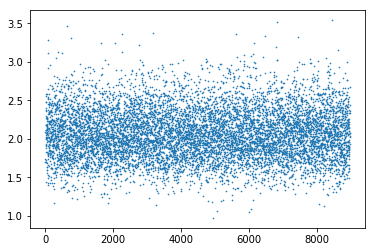

desired_offset = 5466


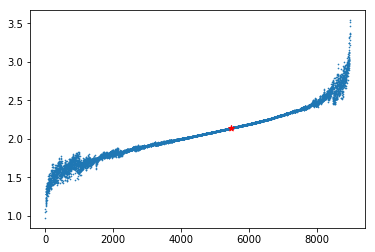

list_size = 10470 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


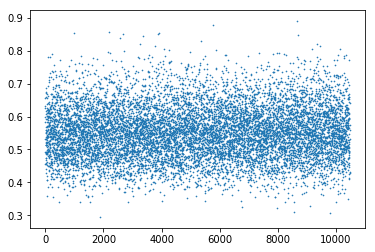

desired_offset = 6984


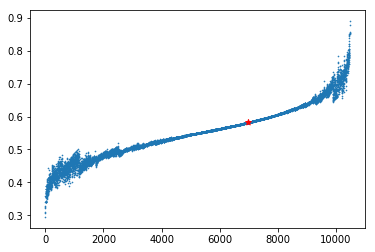

list_size = 12215 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


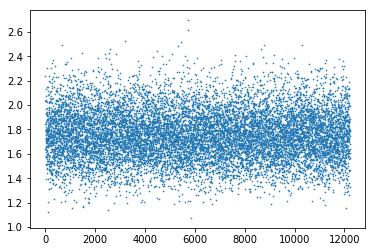

desired_offset = 2405


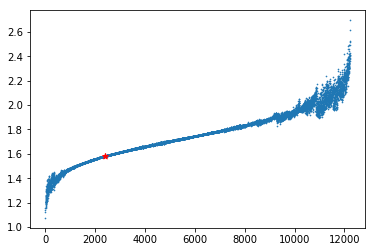

list_size = 14250 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


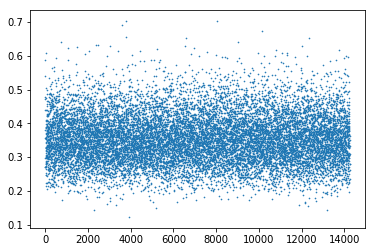

desired_offset = 8751


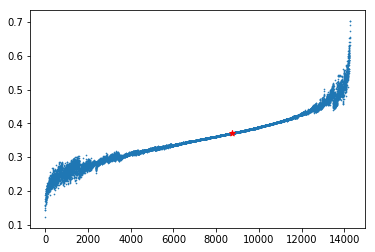

list_size = 16625 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


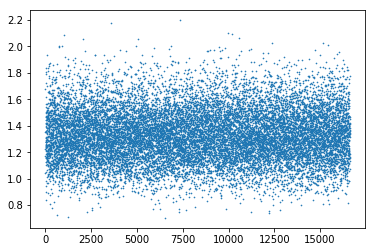

desired_offset = 5689


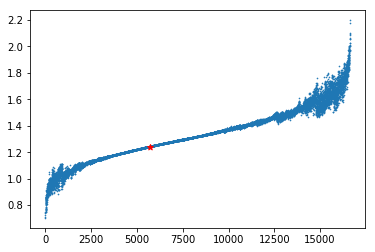

list_size = 19395 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


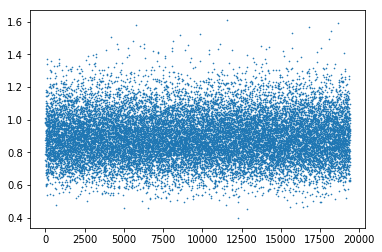

desired_offset = 10017


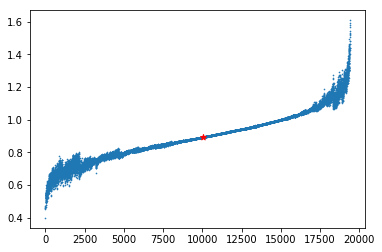

list_size = 22627 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


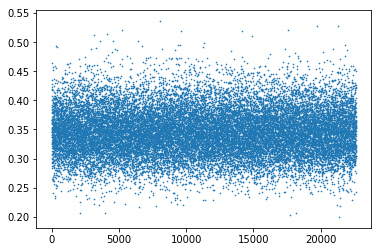

desired_offset = 12320


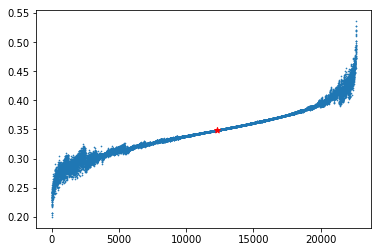

list_size = 26398 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


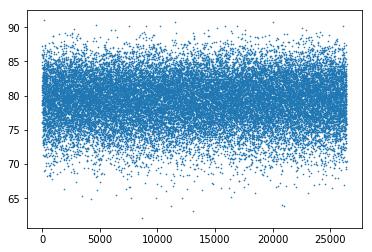

desired_offset = 1528


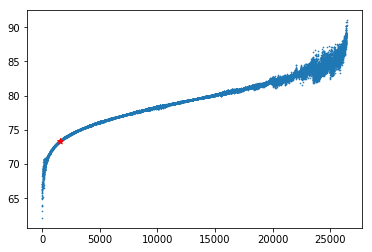

list_size = 30797 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


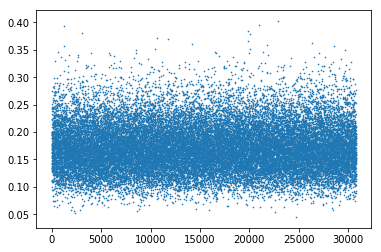

desired_offset = 9264


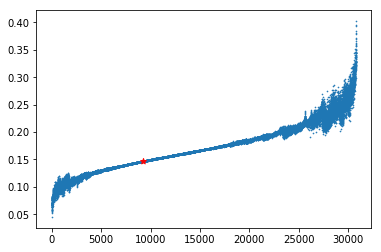

list_size = 35929 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


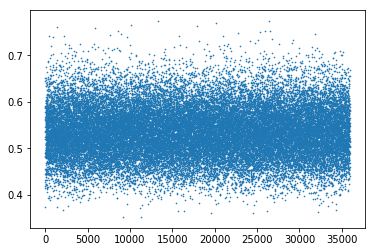

desired_offset = 18331


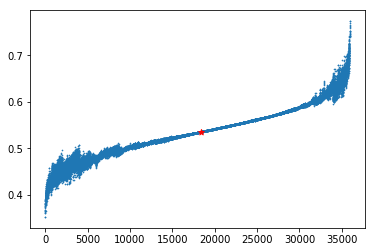

list_size = 41917 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


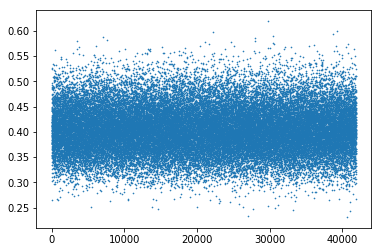

desired_offset = 40692


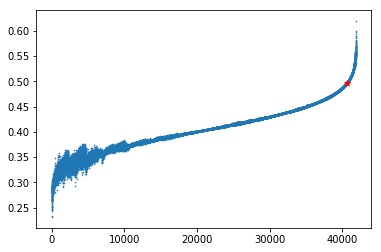

list_size = 48903 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


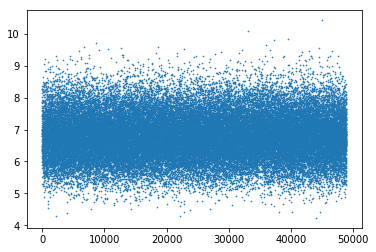

desired_offset = 30224


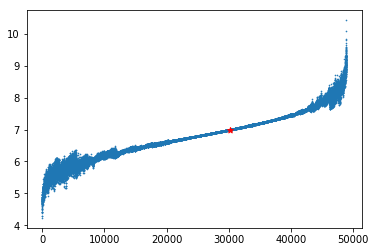

list_size = 57053 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


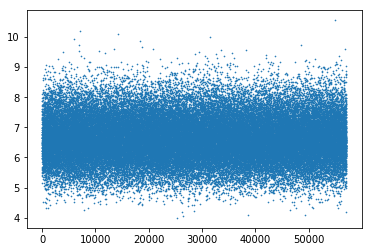

desired_offset = 54975


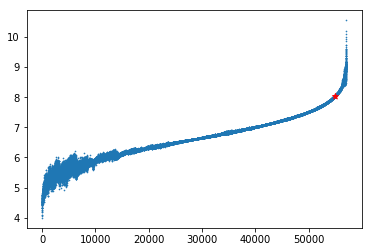

list_size = 66561 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


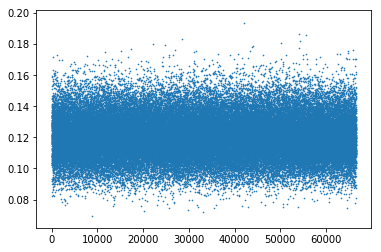

desired_offset = 49907


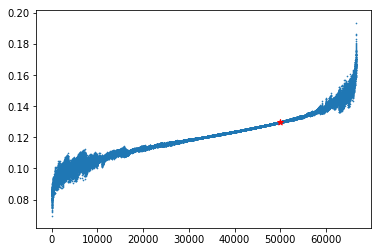

list_size = 77654 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


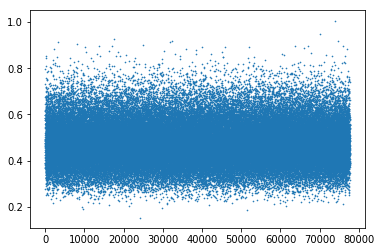

desired_offset = 69780


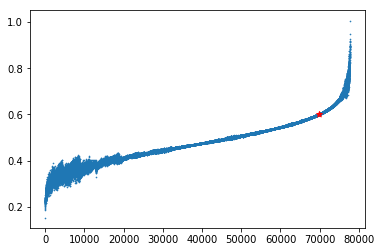

list_size = 90596 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


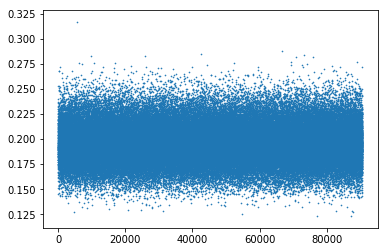

desired_offset = 52262


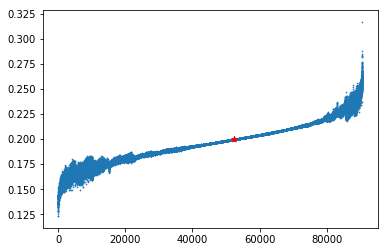

list_size = 105695 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


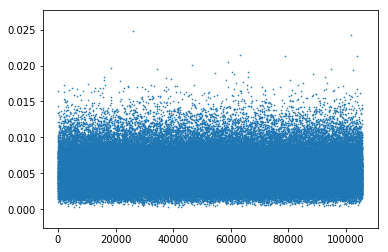

desired_offset = 11297


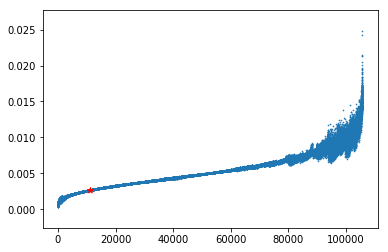

list_size = 123310 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


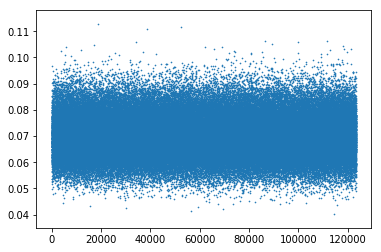

desired_offset = 121771


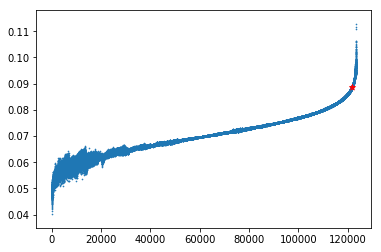

list_size = 143861 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


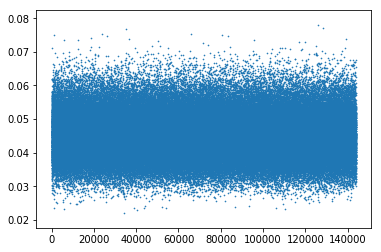

desired_offset = 18314


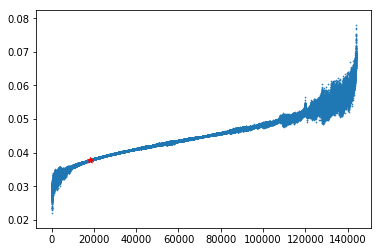

list_size = 167837 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


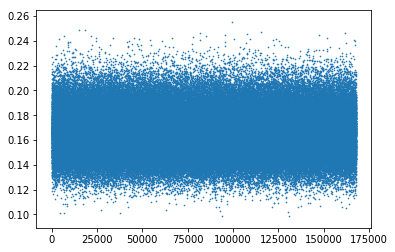

desired_offset = 72451


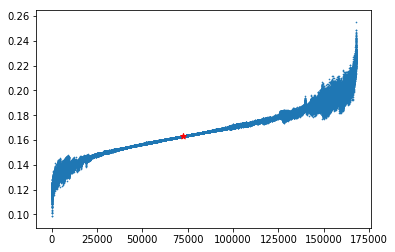

list_size = 195809 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


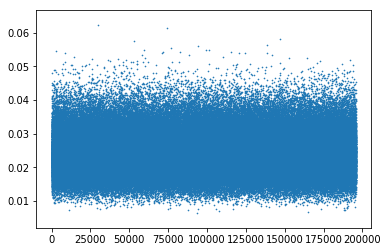

desired_offset = 121295


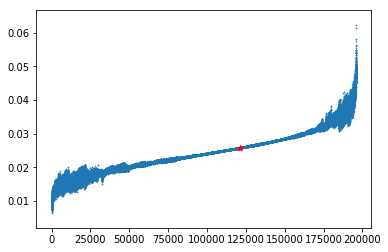

list_size = 228443 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


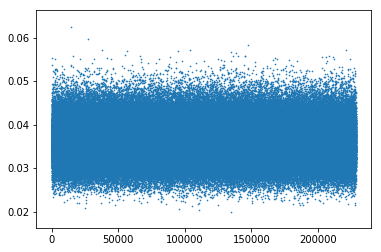

desired_offset = 171387


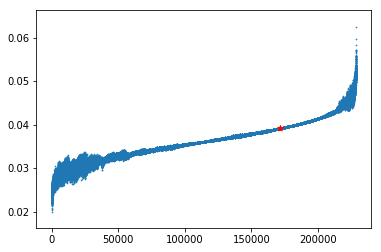

list_size = 266516 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


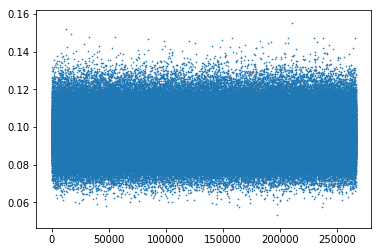

desired_offset = 185416


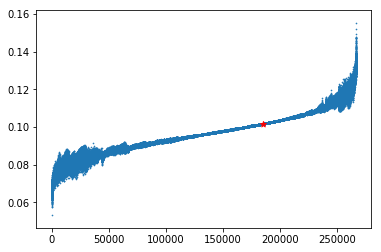

list_size = 310935 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


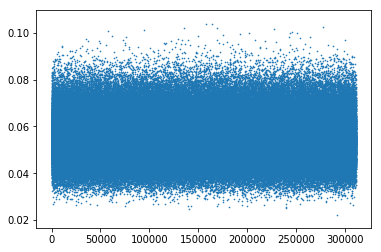

desired_offset = 298538


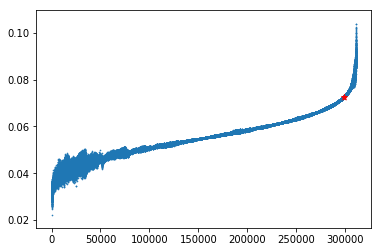

list_size = 362757 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


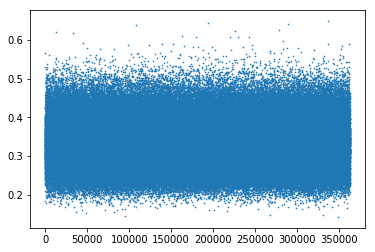

desired_offset = 325123


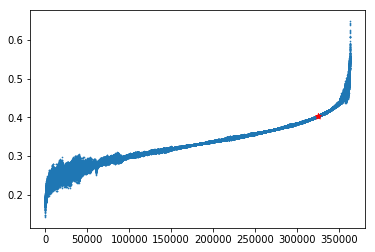

list_size = 423216 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


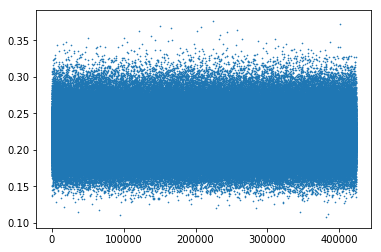

desired_offset = 95715


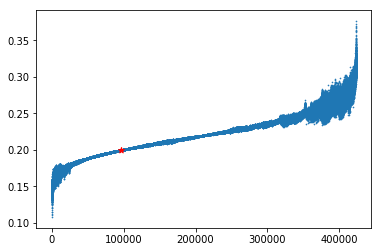

list_size = 493752 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


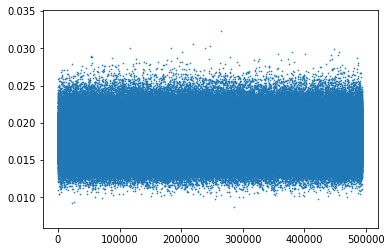

desired_offset = 147267


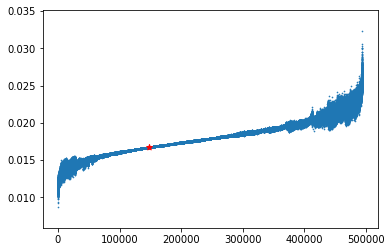

list_size = 576044 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


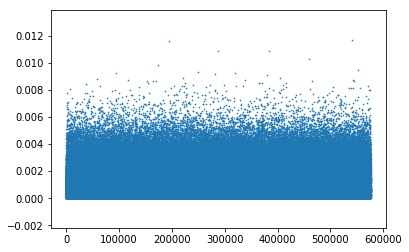

desired_offset = 85364


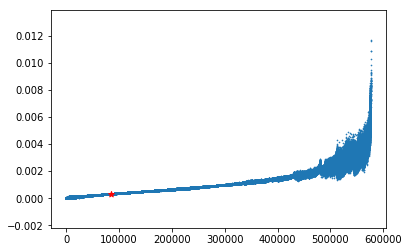

list_size = 672051 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


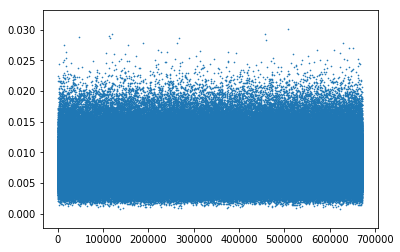

desired_offset = 656164


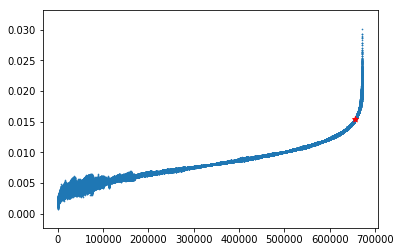

list_size = 784059 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


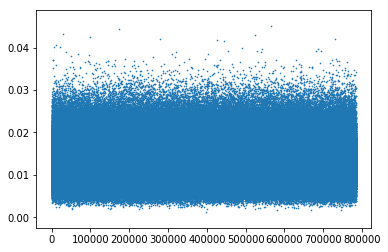

desired_offset = 612425


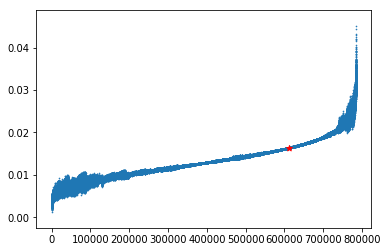

list_size = 914735 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


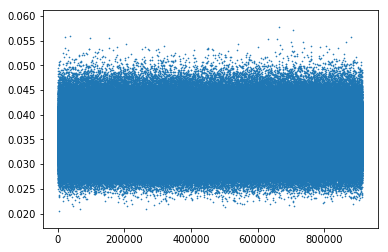

desired_offset = 828385


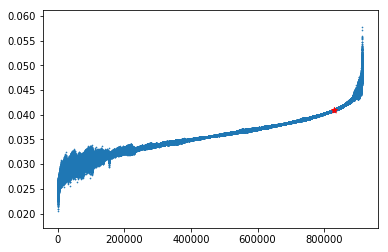

list_size = 1067190 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


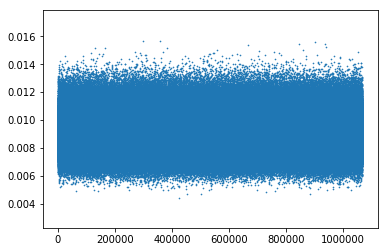

desired_offset = 1055551


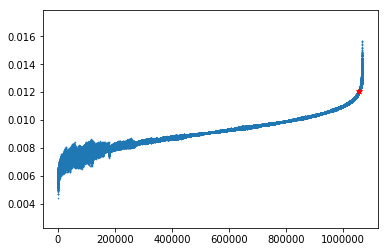

list_size = 1245055 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


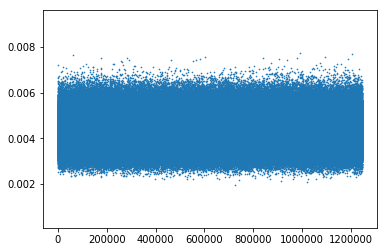

desired_offset = 111489


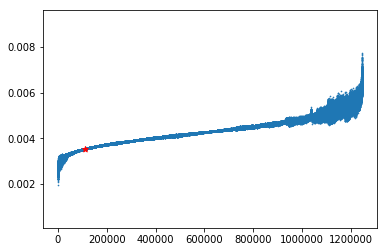

list_size = 1452564 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


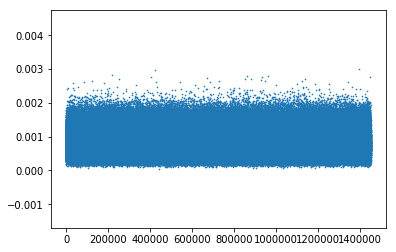

desired_offset = 1202331


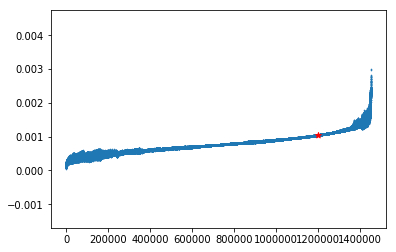

list_size = 1694658 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


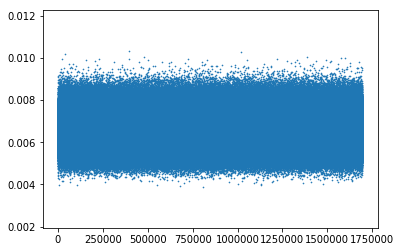

desired_offset = 821005


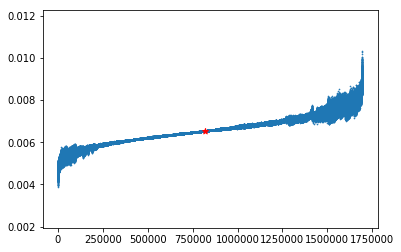

list_size = 1977101 BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:


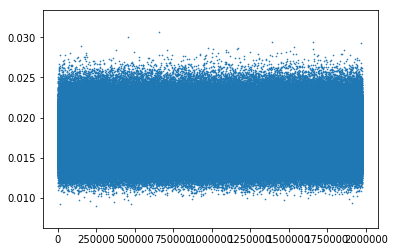

desired_offset = 1572477


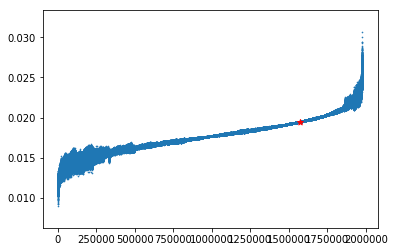

In [6]:
def BiHeapifyInwardsSelectApproximationAndPartitionWithOffset(li, start_offset, total_num_nodes, desired_offset):
    while total_num_nodes > 7:
        BiHeapifyInwardsMedianApproximationAndPartitionWithOffset(li, start_offset, total_num_nodes)
        right_middle_index = total_num_nodes // 2
        left_middle_index  = right_middle_index
        if total_num_nodes % 2 == 0:
            left_middle_index = left_middle_index - 1
        if desired_offset == left_middle_index or desired_offset == right_middle_index:
            return
        total_num_nodes = left_middle_index
        if desired_offset > right_middle_index:
            start_offset += right_middle_index
            desired_offset = desired_offset - right_middle_index
    if total_num_nodes > 1 and total_num_nodes < 8:
          li[start_offset:start_offset + total_num_nodes] = sorted(li[start_offset:start_offset + total_num_nodes])
    return

#If G_sorted is the graph that results from sorting a list, then 
# it should be clear from the scatter plots produced below 
# that the above O(total_num_nodes) function can be used to 
# "zoom in" towards any desired point of G_sorted. 
#In this sense, the above function "locally approximately sorts" a list.
def BiHeapifyInwardsMedianApproximationAndPartitionPlot():
    list_size_start = 2**6
    list_size_end = 2**21
    list_size_increment = 2**6 + 1
    list_size_start_exponential_growth_threshold = 2**10
    list_size_exponential_growth_divisor = 2^4
    list_size = list_size_start
    num_random_lists_per_vec_size = 2**0
    scale = 0.4
    while list_size <= list_size_end:
        ints_list = [x for x in range(list_size)]
        for _ in range(num_random_lists_per_vec_size):
            desired_offset = (int)((list_size - 1) * random.random())
            print('list_size =', list_size, 'BiHeapifyInwardsSelectApproximationAndPartitionWithOffset() will be applied to:')
            alpha = (0.0001 + 100 * random.random())
            beta  = (0.0001 + list_size * random.random())
            li = [100 * random.betavariate(alpha, beta) for _ in range(list_size)] #betavariate, gammavariate, gauss
            plt.scatter(ints_list, li, s = scale)
            plt.show()
            BiHeapifyInwardsSelectApproximationAndPartitionWithOffset(li, 0, list_size, desired_offset)
            print('desired_offset =', desired_offset)
            plt.scatter(ints_list, li, s = scale)
            plt.scatter([desired_offset], [li[desired_offset]], marker = '*', color = 'red')
            plt.show()
        if list_size >= list_size_start_exponential_growth_threshold:#If list_size should increase exponentially
            list_size += list_size // list_size_exponential_growth_divisor
        else:
            list_size += list_size_increment #Else increment list_size linearly.
    return 

BiHeapifyInwardsMedianApproximationAndPartitionPlot()